## METİN ÜRETMEK İÇİN SIFIRDAN BİR GPT MODELİ UYGULAMAK

İşte GPT2 mimarisi aşağıdaki gibir. BU ders boyunca GPT mimarisini inceleyecek ve daha önce öğrendiğimiz mekanizmaları birleştirerek LLM'leri tamamen kavrayacağız.

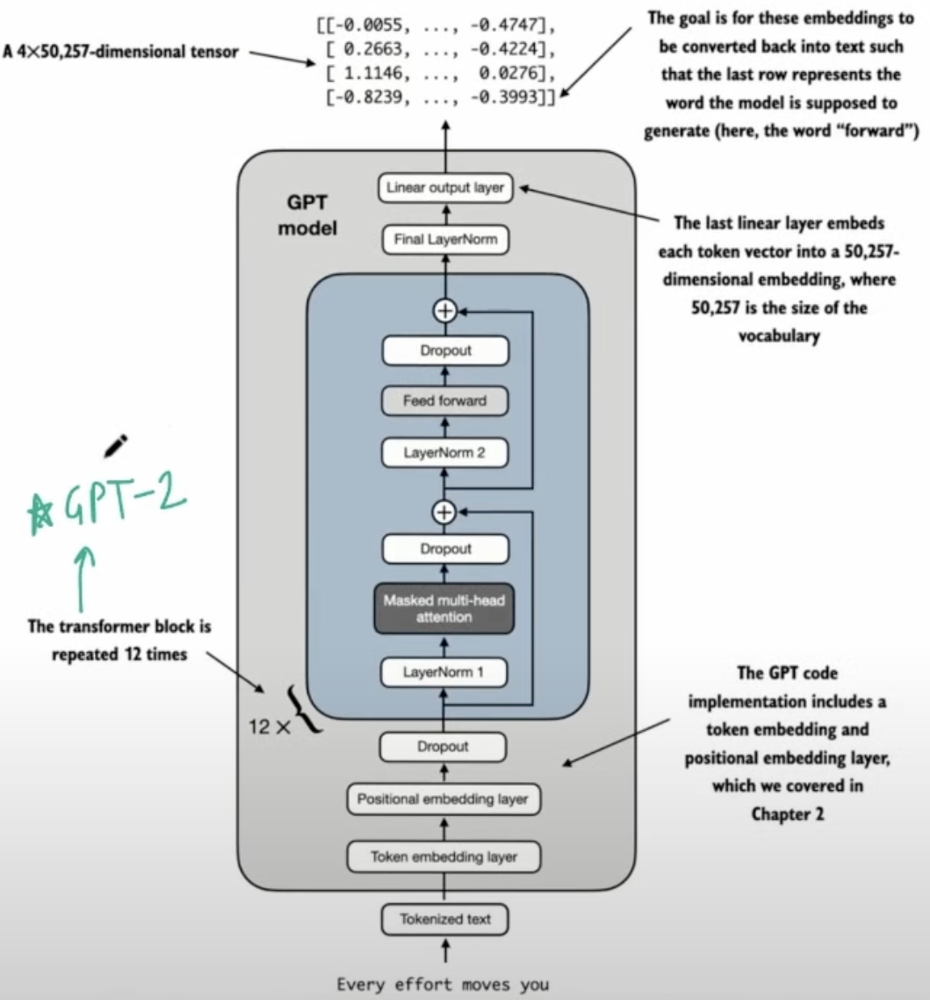

GPT Modelini oluşturmadan önce öğrenmemiz gereken son bir kaç mekanizma daha var. Transformer bloğun en önemli ve karmaşık bileşeni olan attention mekanizmasını öğrendik şimdi ise aşağıdaki diğer blokları kavrayacağız.

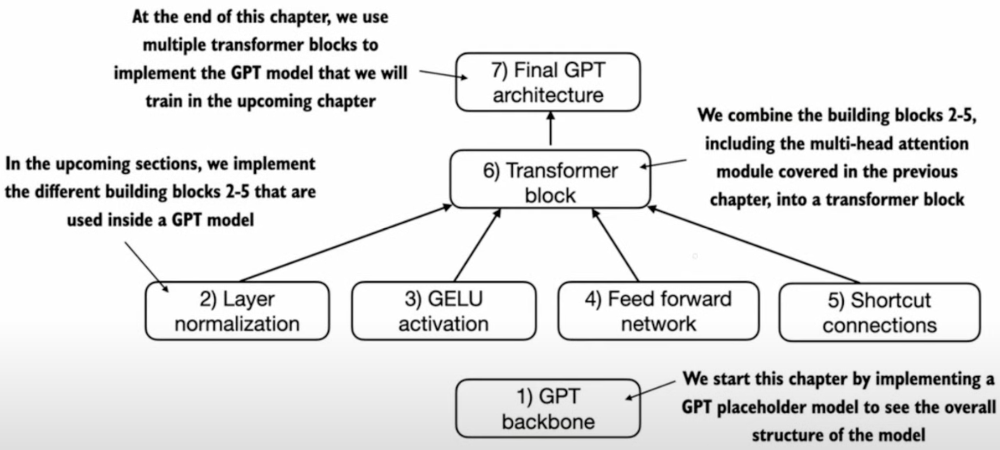

Eveet aşağıdaki görselde de görüldüğü gibi tranformer blok multi-head attetnion mekanizmasının dışında layer normalization, dropout, feed forward layer, GELU aktivasyon gibi diğer mekanizmalardan oluşur.

Bu mekanizmaların sadece temel mantığını anlayarak kod üzerinde işlevini göreceğiz.

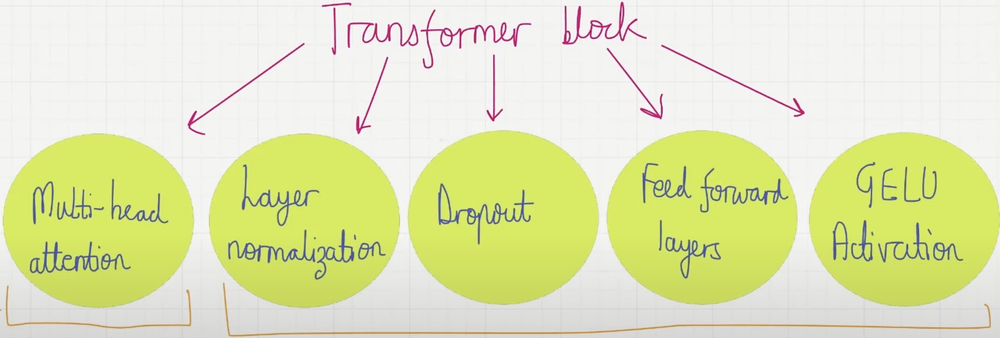

Aşağıdaki tranformer bloğunda da görüldüğü gibi ilk dört ve son dört olarak iki ayrı grup halinde mevcut yapıyı placeholder'lar aracılığıyla kurgulayacağız.

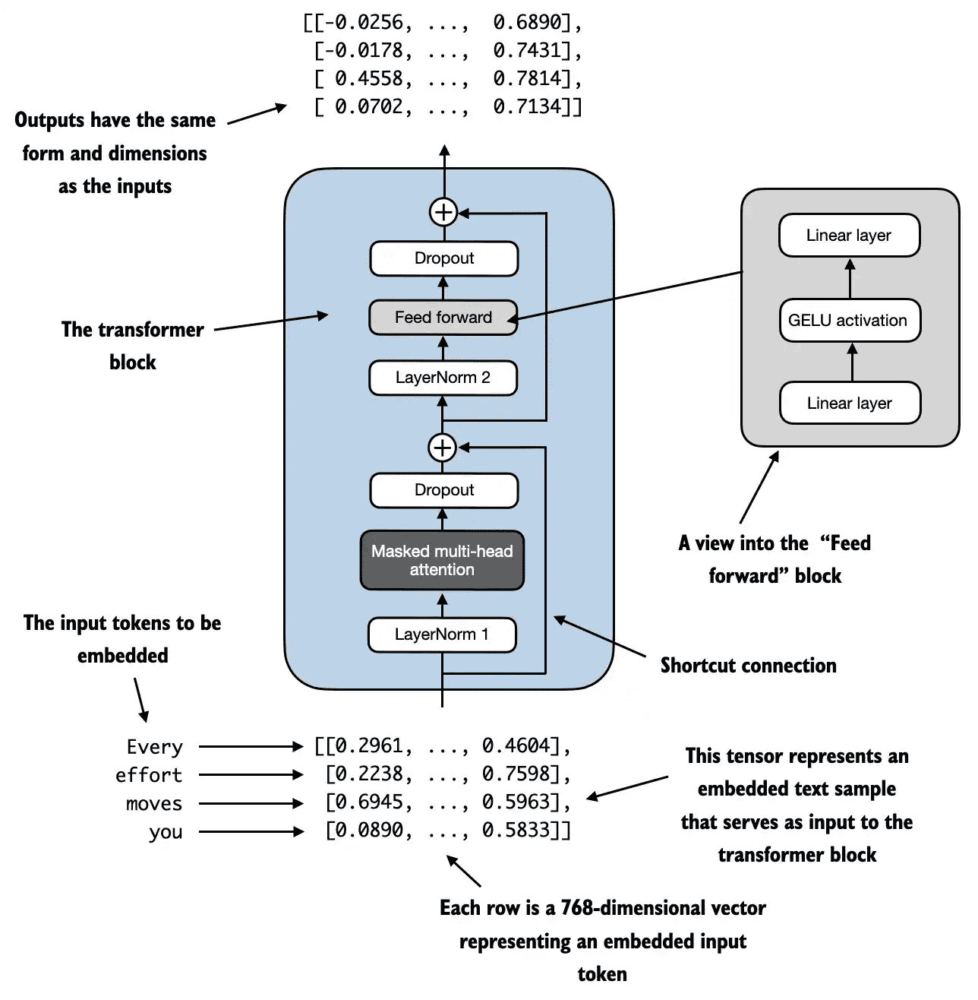

### 1. Layer Normalization

Temel amacı, modelin öğrenme sürecini daha stabil ve hızlı hale getirmektir. Layer normalization, bir sinir ağı katmanındaki her bir örnek için özellikler (features) bazında normalizasyon yapar. Bu da eğitimin daha stabil olmasını, ağırlıkların daha hızlı yakınsamasını sağlar ve eğitimi kolaylaştırır.

Aşağıdaki görselde de görüldüğü gibi layer normalizasyonu sonucu ortalama sıfır, varyans bir olur.
 

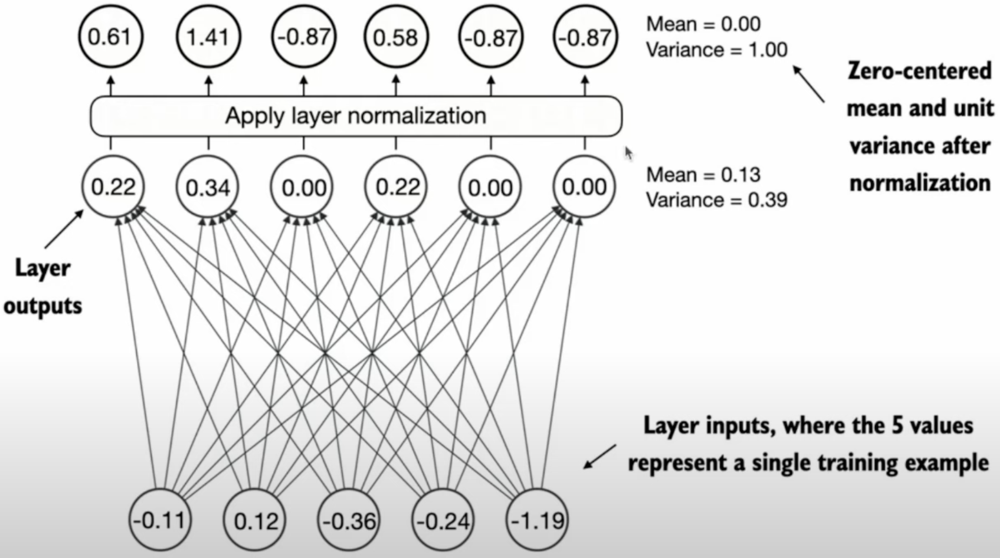

### 2. Dropout

Dropout, derin öğrenme modellerinde aşırı öğrenmeyi (overfitting) önlemek için kullanılan çok etkili ve yaygın bir düzenleme (regularization) yöntemidir.

Dropout, eğitim sırasında yapay sinir ağındaki bazı nöronları rastgele geçici olarak devre dışı bırakır (yani "drop" eder).

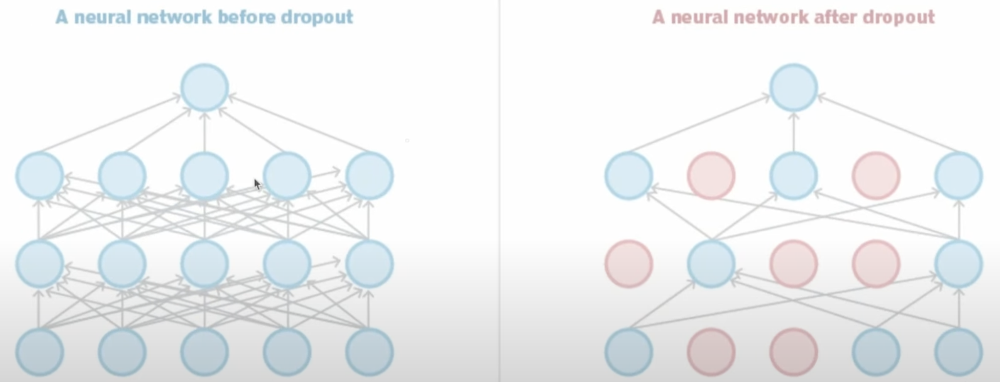

### 3. Feed Forward Layer ve GELU

Feed Forward Layer (FFN ya da FFN Layer olarak da bilinir), girişten çıkışa doğru doğrusal (non-recurrent) bir şekilde akan bir katmandır. Genellikle iki tam bağlantılı (fully connected) katmandan oluşur ve arada bir aktivasyon fonksiyonu bulunur.

Örneğin bir Transformer katmanında (GPT2):

* Girdi boyutu: 768

* Gizli katman boyutu (hidden size): 3072

Şu adımlarla işler:

1. 768 → 3072 (Linear1)

2. GELU

3. 3072 → 768 (Linear2)

Feed Forward Layer, modelin temsil gücünü artırarak lineer olmayan dönüşümler sağlar.

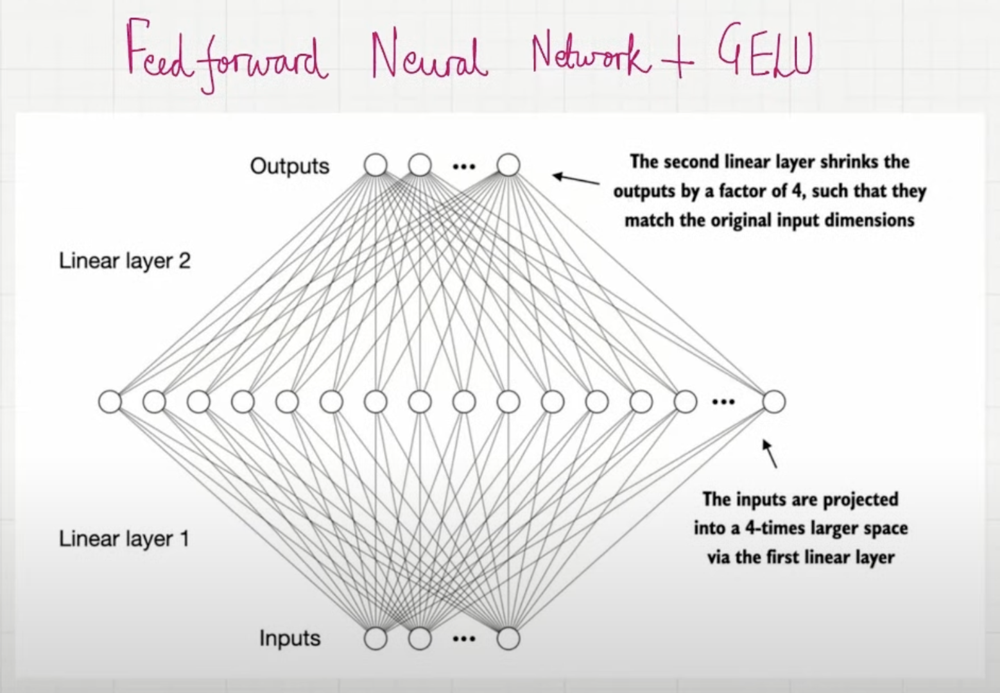

GELU (Gaussian Error Linear Unit), modern derin öğrenme modellerinde, özellikle Transformer tabanlı modeller (GPT-2, BERT, T5, vs.) tarafından yaygın şekilde kullanılan bir aktivasyon fonksiyonudur. ReLU gibi klasik fonksiyonlara göre daha yumuşak ve probabilistik bir geçiş sunar.

Ayrıca GELU aktivasyon fonksiyonu, “dead neuron” (ölü nöron) problemine karşı ReLU’ya kıyasla daha dayanıklıdır. Çünkü GELU, küçük negatif değerleri tamamen sıfırlamaz, nöronların tamamen pasifleşmesini engeller, öğrenmeyi canlı tutar ve daha stabil hale getirir.

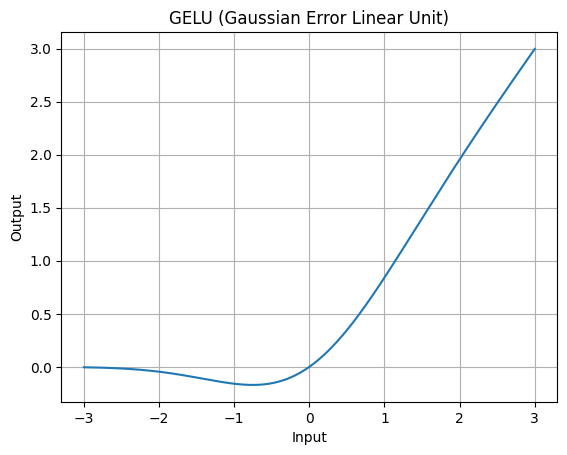

### 4. Shortcut/Skip Connections

Girdi verisinin, bazı katmanlardan geçmeden doğrudan daha ileri katmanlara aktarılmasıdır.

Yani modelin içindeki bazı katmanlar “atlanır” ama yine de girdi bilgisi ileri katmana ulaşır.

Bu bağlantılar gradyan kaybını (vanishing gradient) ve bilgi kaybını azaltır ve eğitimi hızlandırır.

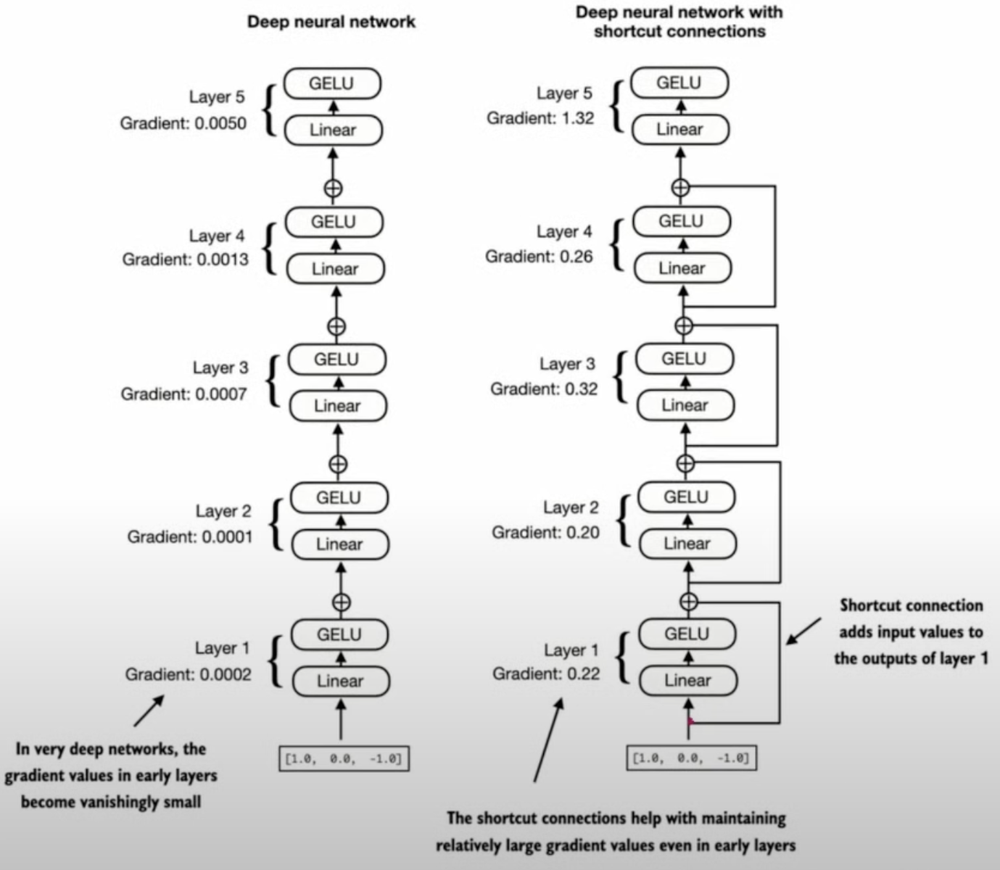

Daha önceki GPT mimarisi bloğunda gördüğümüz ve öğrendiğimiz üzere tam bir LLM modeli sırasıyla aşağıdaki aşamaları gerçekleştirir.

1. 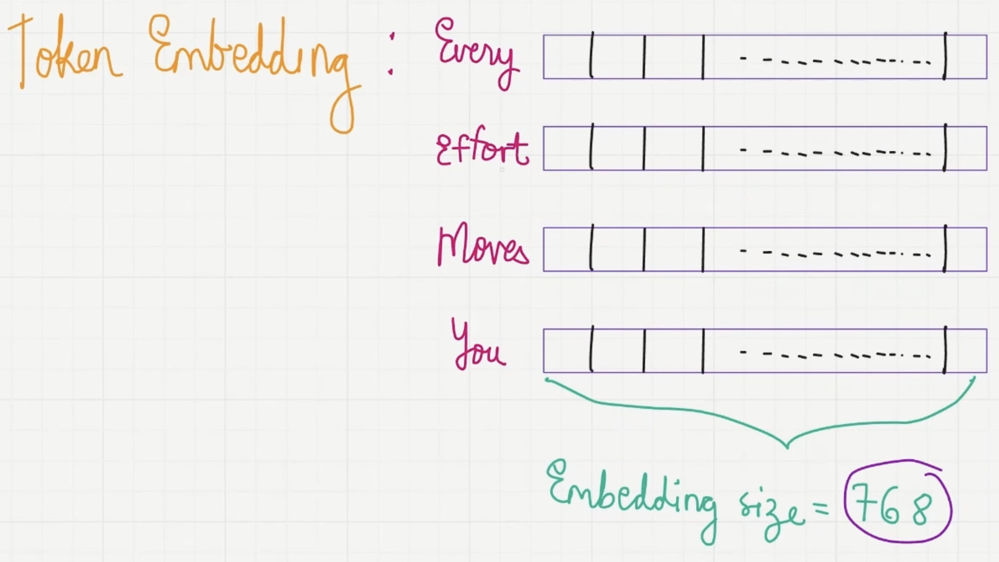

2. 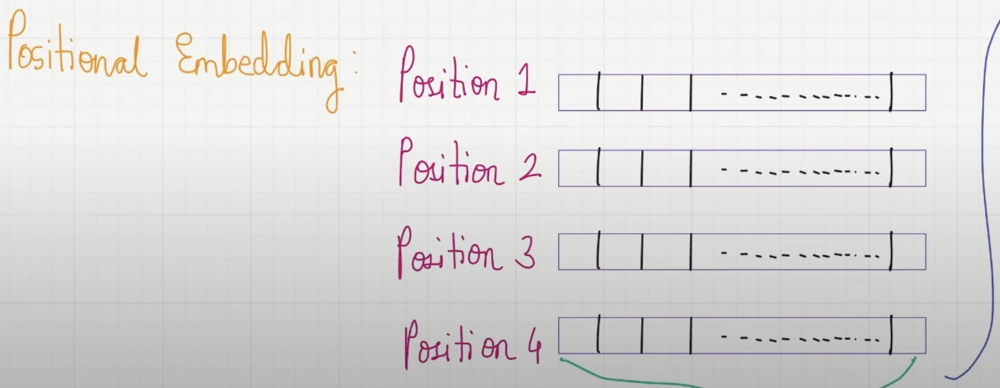

3. 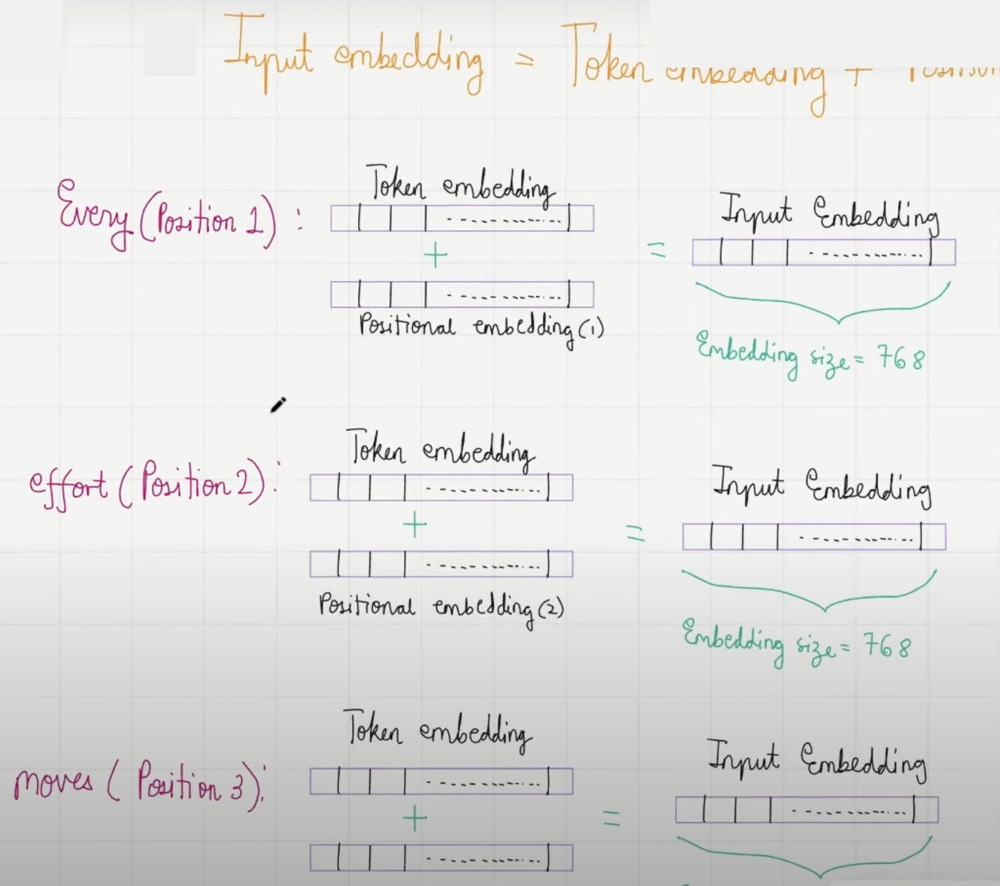

4. 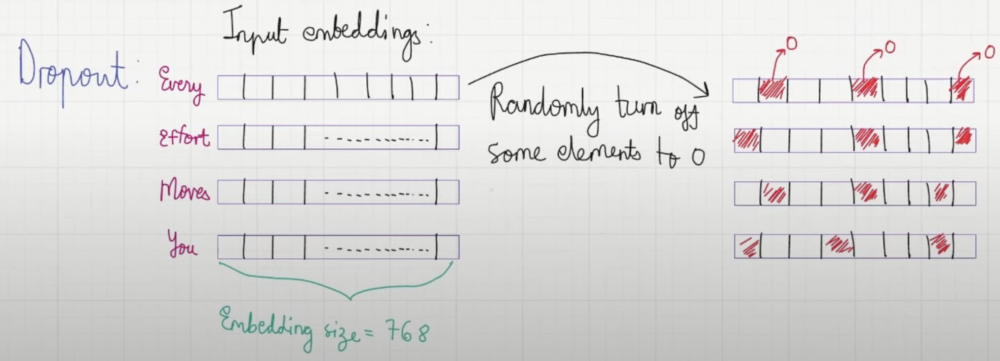

5. 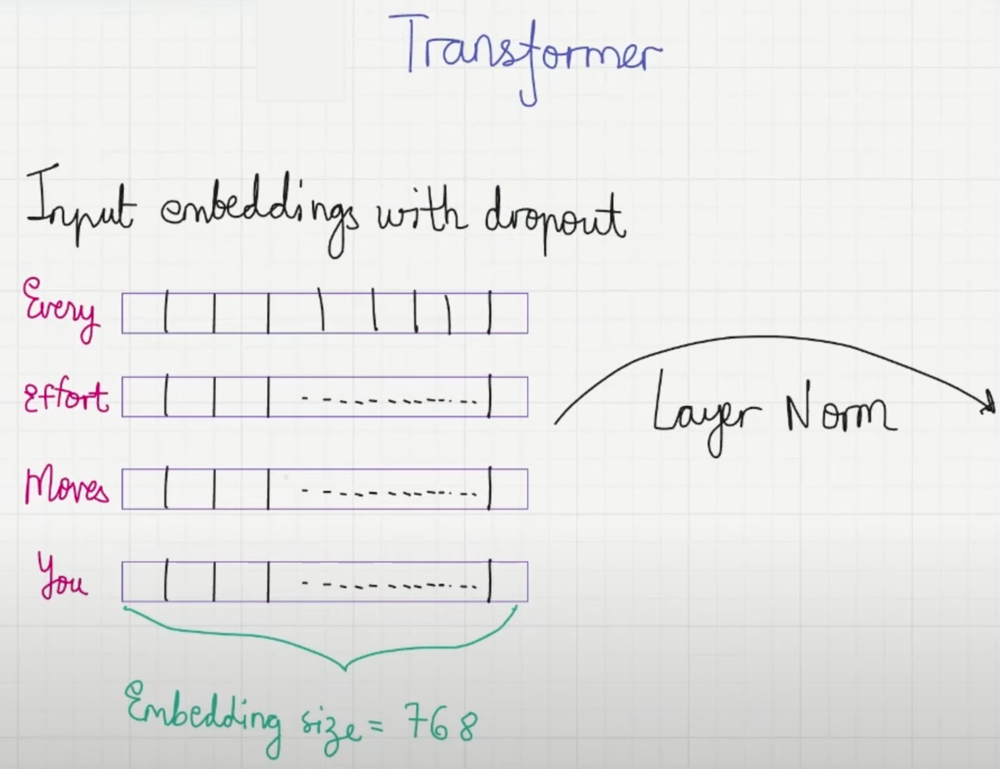

6. 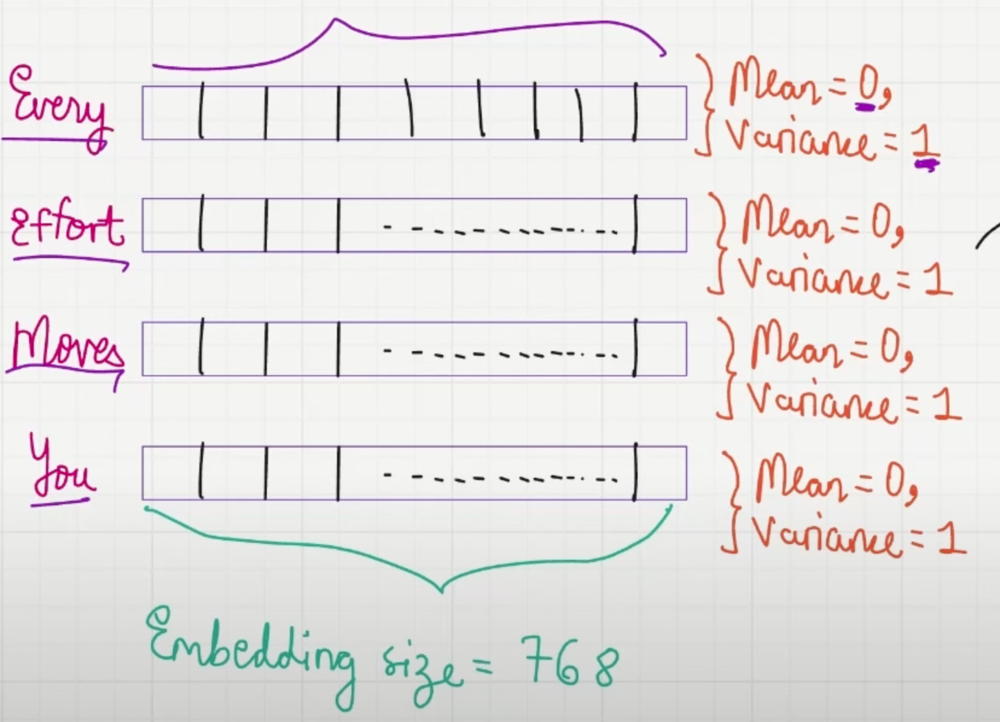

7. 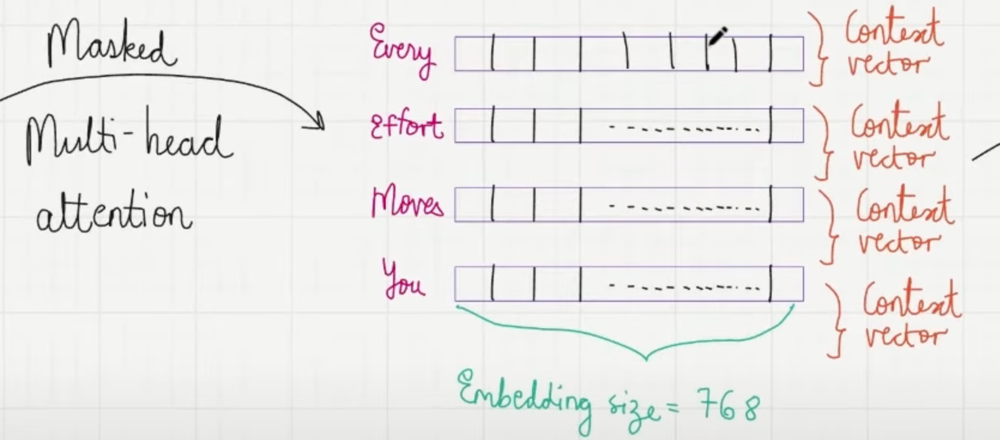

8. 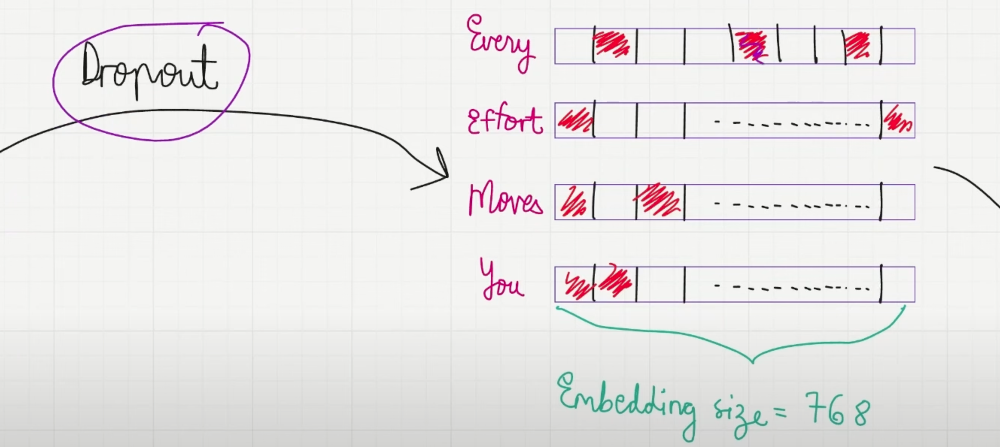

9. 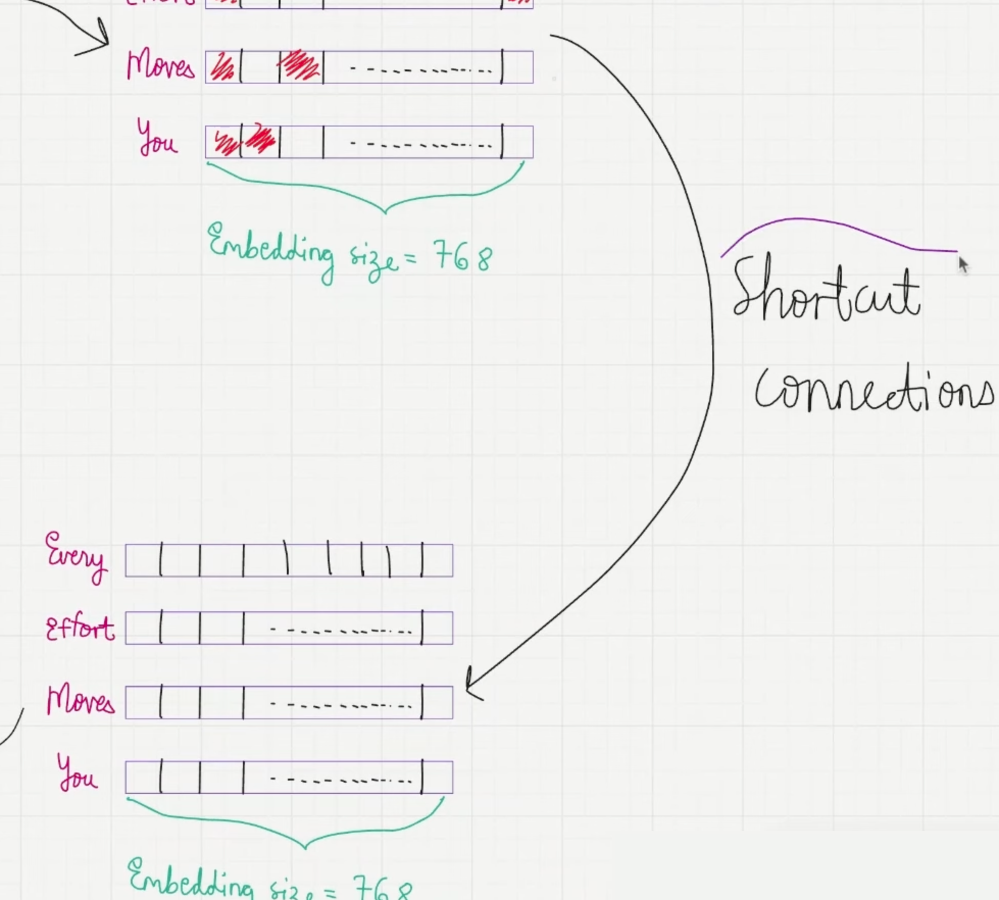

10. 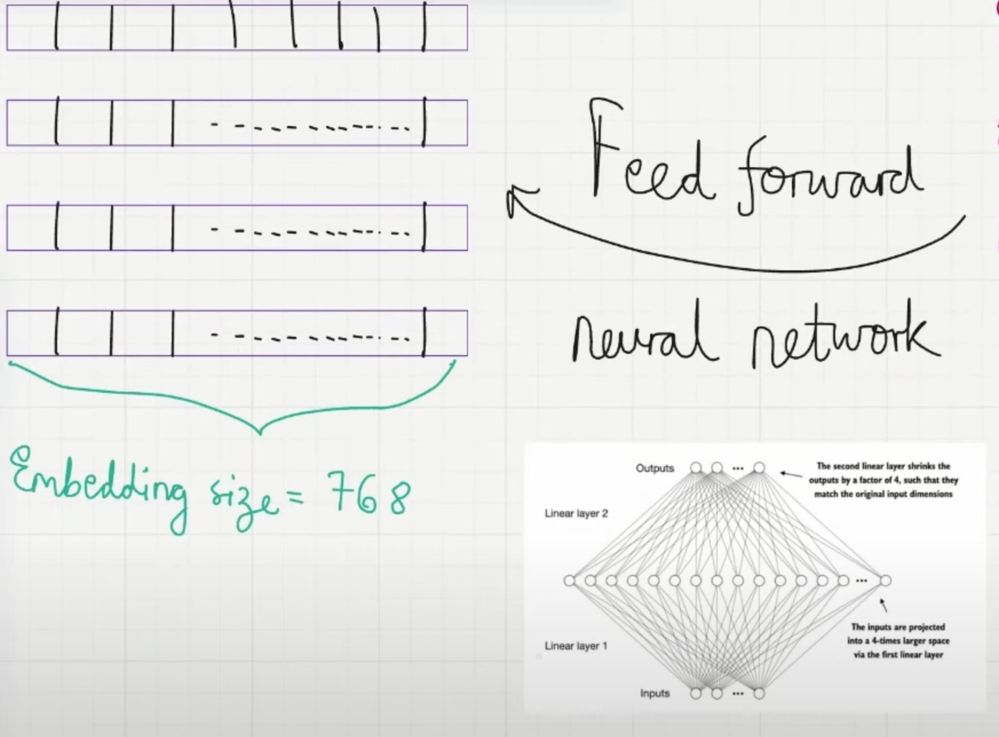

11. 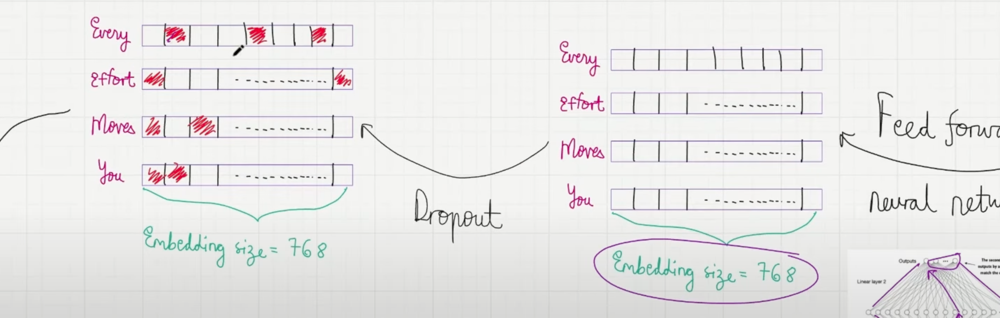

12. 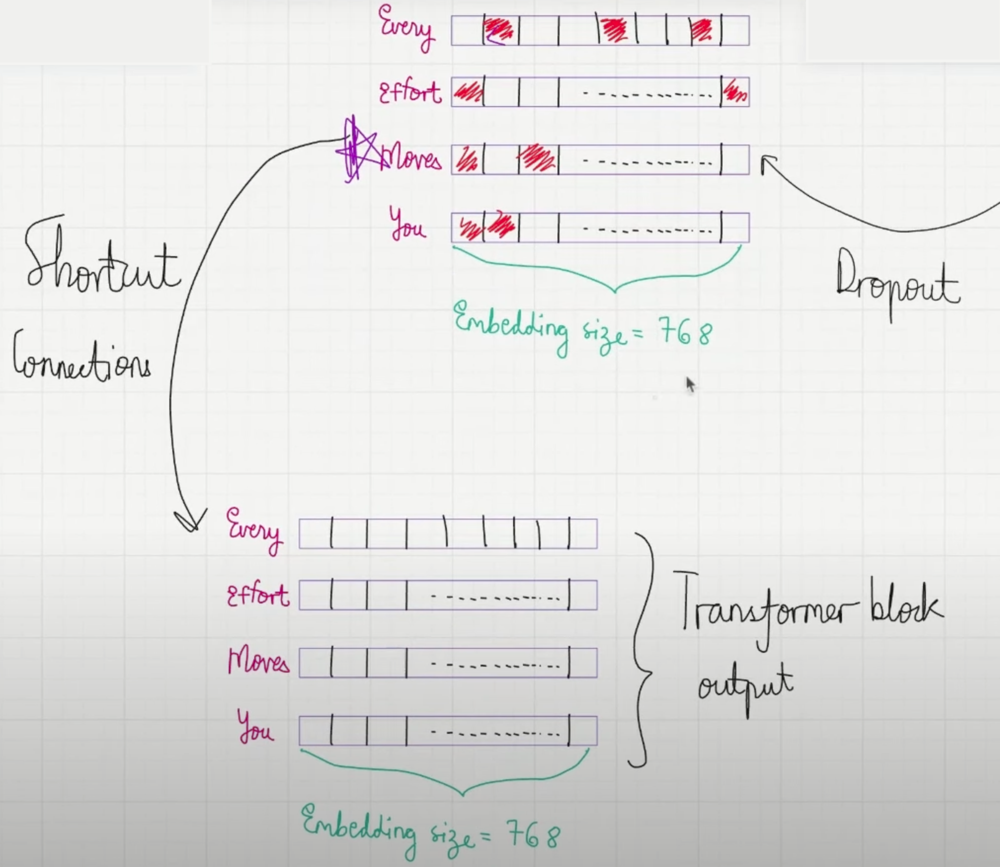

13. 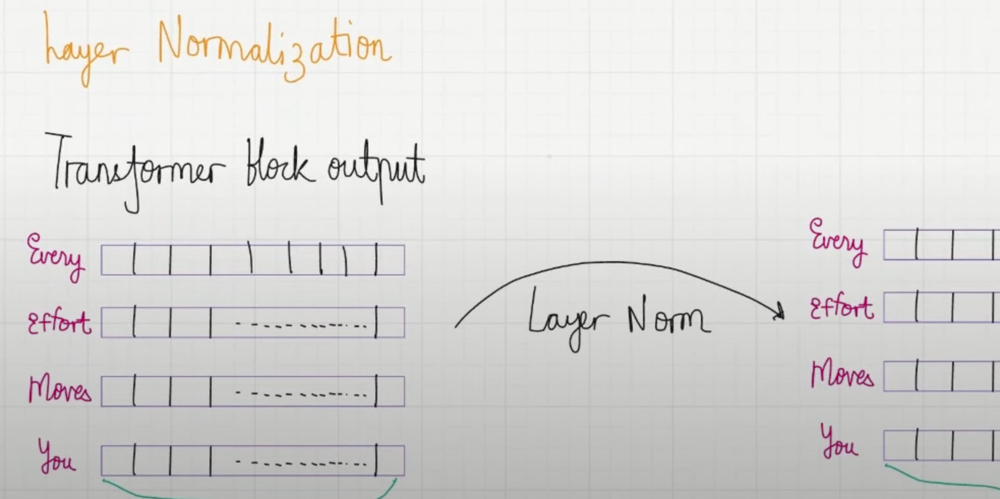

14. 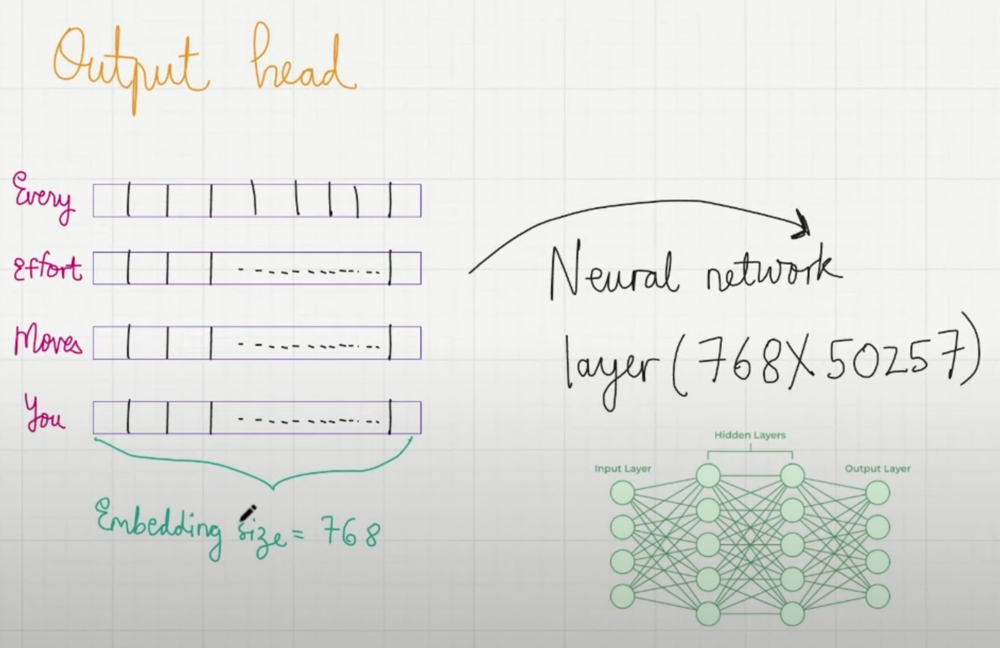
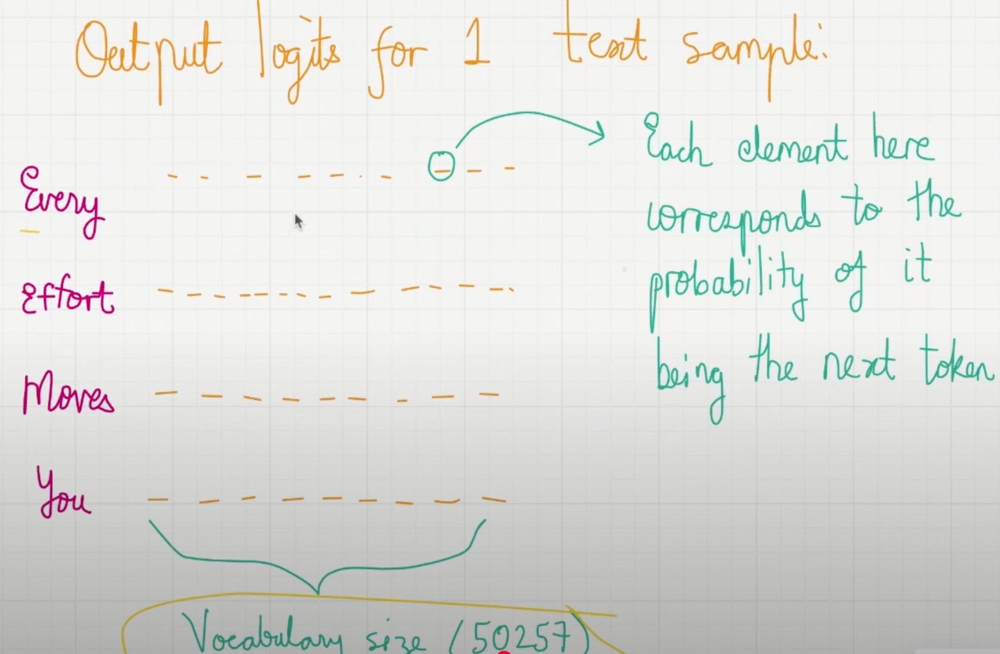

In [2]:
GPT_CONFIG_124M = {
    "vocab_size": 50257,    # Vocabulary boyutu
    "context_length": 1024, # Context uzunluğu
    "emb_dim": 768,         # Embedding boyutu
    "n_heads": 12,          # Attention head sayısı
    "n_layers": 12,         # Layer sayısı
    "drop_rate": 0.1,       # Dropout oranı
    "qkv_bias": False       # Query-Key-Value bias
}

## GPT MİMARİSİ BÖLÜM 1: BASİT GPT MODEL SINIFI

<div class="alert alert-block alert-info">

Adım 1: TransformerBlock için bir yer tutucu (placeholder) kullan

Adım 2: LayerNorm için bir yer tutucu (placeholder) kullan
</div>

In [3]:
import torch
import torch.nn as nn


class DummyGPTModel(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.tok_emb = nn.Embedding(cfg["vocab_size"], cfg["emb_dim"])
        self.pos_emb = nn.Embedding(cfg["context_length"], cfg["emb_dim"])
        self.drop_emb = nn.Dropout(cfg["drop_rate"])
        
        # TransformerBlock
        self.trf_blocks = nn.Sequential(
            *[DummyTransformerBlock(cfg) for _ in range(cfg["n_layers"])])
        
        # LayerNorm
        self.final_norm = DummyLayerNorm(cfg["emb_dim"])
        self.out_head = nn.Linear(
            cfg["emb_dim"], cfg["vocab_size"], bias=False
        )

    def forward(self, in_idx):
        batch_size, seq_len = in_idx.shape
        tok_embeds = self.tok_emb(in_idx)
        pos_embeds = self.pos_emb(torch.arange(seq_len, device=in_idx.device))
        x = tok_embeds + pos_embeds
        x = self.drop_emb(x)
        x = self.trf_blocks(x)
        x = self.final_norm(x)
        logits = self.out_head(x)
        return logits


class DummyTransformerBlock(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        # Simple placeholder

    def forward(self, x):
        # Bu blok sadece girişi döndürür.
        return x


class DummyLayerNorm(nn.Module):
    def __init__(self, normalized_shape, eps=1e-5):
        super().__init__()
        # Buradaki parametreler sadece LayerNorm arayüzünü taklit etmek içindir.

    def forward(self, x):
        # Bu blok sadece girişi döndürür.
        return x

<div class="alert alert-block alert-warning">

DummyGPT sınıfı, gerçek bir uygulama yerine, sınıf yapısını ve veri akışını göstermek amacıyla hazırlanmıştır.

DummyGPTModel sınıfındaki model mimarisi, token, positional embeddingler, dropout, bir dizi transformer blok (DummyTransformerBlock), son katman normalizasyonu (DummyLayerNorm) ve doğrusal bir çıktı katmanından (out_head) oluşur.

Konfigürasyonlar, örneğin daha önce oluşturduğumuz GPT_CONFIG_124M gibi bir Python dictionary aracılığıyla aktarılır.

</div>

<div class="alert alert-block alert-warning">

Forward metodu, modeldeki veri akışını açıklar: giriş endeksleri için token ve positional embeddinleri hesaplar, dropout uygular, verileri transformer bloklar aracılığıyla işler, normalleştirmeyi uygular ve son olarak doğrusal çıktı katmanıyla lojikleri üretir.

</div>

<div class="alert alert-block alert-warning">

Yukarıdaki kod zaten işlevseldir, bunu giriş verilerini hazırladıktan sonra bu bölümde daha sonra göreceğiz.

Ancak şimdilik yukarıdaki kodda transformer bloğu ve layer normalizasyonu için yer tutucular
(DummyLayerNorm ve DummyTransformerBlock) kullandığımızı unutmayın, bunları daha sonraki bölümlerde geliştireceğiz

</div>

<div class="alert alert-block alert-success">

Daha sonra, giriş verilerini hazırlayacağız ve kullanımını göstermek için yeni bir GPT modeli başlatacağız.

</div>

### ADIM 1: TOKENIZATION

In [4]:
import tiktoken
tokenizer = tiktoken.get_encoding("gpt2")
batch = []
txt1 = "Every effort moves you"
txt2 = "Every day holds a"
batch.append(torch.tensor(tokenizer.encode(txt1)))
batch.append(torch.tensor(tokenizer.encode(txt2)))
batch = torch.stack(batch, dim=0)
print(batch)

tensor([[6109, 3626, 6100,  345],
        [6109, 1110, 6622,  257]])


### ADIM 2: DUMMYGPTMODEL'İN BİR ÖRNEĞİNİ OLUŞTURUN

In [5]:
torch.manual_seed(123)
model = DummyGPTModel(GPT_CONFIG_124M)
logits = model(batch)
print("Output shape:", logits.shape)
print(logits)

Output shape: torch.Size([2, 4, 50257])
tensor([[[-1.2034,  0.3201, -0.7130,  ..., -1.5548, -0.2390, -0.4667],
         [-0.1192,  0.4539, -0.4432,  ...,  0.2392,  1.3469,  1.2430],
         [ 0.5307,  1.6720, -0.4695,  ...,  1.1966,  0.0111,  0.5835],
         [ 0.0139,  1.6754, -0.3388,  ...,  1.1586, -0.0435, -1.0400]],

        [[-1.0908,  0.1798, -0.9484,  ..., -1.6047,  0.2439, -0.4530],
         [-0.7860,  0.5581, -0.0610,  ...,  0.4835, -0.0077,  1.6621],
         [ 0.3567,  1.2698, -0.6398,  ..., -0.0162, -0.1296,  0.3717],
         [-0.2407, -0.7349, -0.5102,  ...,  2.0057, -0.3694,  0.1814]]],
       grad_fn=<UnsafeViewBackward0>)


<div class="alert alert-block alert-warning">

Çıktı tensörü, iki metin örneğine karşılık gelen iki satıra sahiptir. Her metin örneği 4 tokendan oluşur; her token, tokenizer'ın vocabulary boyutuyla eşleşen 50.257 boyutlu bir vektördür.


Embedding, 50.257 boyuta sahiptir çünkü bu boyutların her biri vocabulary'deki benzersiz bir token'a atıfta bulunur. Bu bölümün sonunda, son işlem (post-proccessing) kodunu uyguladığımızda, bu 50.257 boyutlu vektörleri token-id'lere geri dönüştüreceğiz ve böylece bunları daha sonra kelimelere dönüştürebiliriz.

</div>

<div class="alert alert-block alert-warning">

Artık GPT mimarisine ve onun giriş ve çıkışlarına yukarıdan aşağıya bir göz attığımıza göre, önümüzdeki bölümlerde bireysel yer tutucuları kodlayacağız; önceki kodda DummyLayerNorm'un yerini alacak gerçek layer normalizasyon sınıfıyla başlayacağız.

</div>

## GPT MİMARİSİ PART 2: LAYER NORMALIZATION

#### Basit bir örnek ile açıklama

In [6]:
torch.manual_seed(123)
batch_example = torch.randn(2, 5) #A
layer = nn.Sequential(nn.Linear(5, 6), nn.ReLU())
out = layer(batch_example)
print(out)

tensor([[0.2260, 0.3470, 0.0000, 0.2216, 0.0000, 0.0000],
        [0.2133, 0.2394, 0.0000, 0.5198, 0.3297, 0.0000]],
       grad_fn=<ReluBackward0>)


<div class="alert alert-block alert-info">

Kodladığımız sinir ağı katmanı, linear layer ardından non-linear activasyon fonksiyonu olan ReLU'dan (Rectified Linear Unit'in kısaltması) oluşur; bu, sinir ağlarında standart bir aktivasyon fonksiyonudur.

ReLU'ya aşina değilseniz, bu, negatif girdileri 0'a kadar eşikler ve bir katmanın yalnızca pozitif değerler üretmesini sağlar; bu da ortaya çıkan katman çıktısının neden negatif değerler içermediğini açıklar.

(GPT'de bir sonraki bölümde tanıtacağımız daha sofistike bir aktivasyon fonksiyonu daha kullanacağımızı unutmayın).

</div>

<div class="alert alert-block alert-success">

Bu çıktılara layer normalizasyonunu uygulamadan önce, ortalamayı ve varyansı inceleyelim:

</div>

In [7]:
mean = out.mean(dim=-1, keepdim=True)
var = out.var(dim=-1, keepdim=True)
print("Mean:\n", mean)
print("Variance:\n", var)

Mean:
 tensor([[0.1324],
        [0.2170]], grad_fn=<MeanBackward1>)
Variance:
 tensor([[0.0231],
        [0.0398]], grad_fn=<VarBackward0>)


<div class="alert alert-block alert-warning">

Yukarıdaki ortalama tensöründeki ilk satır, ilk girdi satırının ortalama değerini içerir ve ikinci çıktı satırı, ikinci girdi satırının ortalamasını içerir.

</div>

<div class="alert alert-block alert-warning">

Ortalama veya varyans hesaplaması gibi işlemlerde keepdim=True kullanmak, işlem tensörü dim ile belirtilen boyut boyunca azaltsa bile, çıktı tensörünün giriş tensörüyle aynı sayıda boyutu korumasını sağlar.

Örneğin,
keepdim=True olmadan, döndürülen ortalama tensör 2×1 boyutlu bir matris [[0.1324], [0.2170]] yerine 2 boyutlu bir vektör [0.1324, 0.2170] olur.

</div>

<div class="alert alert-block alert-warning">

2 boyutlu bir tensör (matris gibi) için, ortalama veya varyans hesaplaması gibi işlemler için dim=-1 kullanmak dim=1 kullanmakla aynıdır.

Bunun nedeni, -1'in 2 boyutlu bir tensördeki sütunlara karşılık gelen tensörün son boyutunu ifade etmesidir.

Daha sonra, GPT modeline layer normalizasyonu eklerken, [batch_size, num_tokens, embedding_size] şeklinde 3 boyutlu tensörler üretirken, son boyut boyunca normalizasyon için dim=-1 kullanmaya devam edebilir ve dim=1'den dim=2'ye geçişi önleyebiliriz.

</div>

<div class="alert alert-block alert-success">

Daha sonra, daha önce elde ettiğimiz layer çıktılarına layer normalizasyonunu uygulayalım.
İşlem, ortalamayı çıkarmak ve varyansın kareköküne bölmekten oluşur
(standart sapma olarak da bilinir):

</div>

In [8]:
out_norm = (out - mean) / torch.sqrt(var)
mean = out_norm.mean(dim=-1, keepdim=True)
var = out_norm.var(dim=-1, keepdim=True)
print("Normalized layer outputs:\n", out_norm)
print("Mean:\n", mean)
print("Variance:\n", var)

Normalized layer outputs:
 tensor([[ 0.6159,  1.4126, -0.8719,  0.5872, -0.8719, -0.8719],
        [-0.0189,  0.1121, -1.0876,  1.5173,  0.5647, -1.0876]],
       grad_fn=<DivBackward0>)
Mean:
 tensor([[-5.9605e-08],
        [ 1.9868e-08]], grad_fn=<MeanBackward1>)
Variance:
 tensor([[1.0000],
        [1.0000]], grad_fn=<VarBackward0>)


<div class="alert alert-block alert-info">

Çıkış tensöründeki 2.9802e-08 değerinin 2.9802 ×
10-8 için bilimsel gösterim olduğunu ve ondalık biçimde 0.0000000298 olduğunu unutmayın. Bu değer 0'a çok yakındır, ancak bilgisayarların sayıları temsil ettiği sonlu hassasiyet nedeniyle birikebilen küçük sayısal hatalar nedeniyle tam olarak 0 değildir.

</div>

<div class="alert alert-block alert-success">

Okunabilirliği artırmak için, tensör değerlerini yazdırırken bilimsel gösterimi sci_mode'u False olarak ayarlayarak kapatabiliriz:

</div>

In [9]:
torch.set_printoptions(sci_mode=False)
print("Mean:\n", mean)
print("Variance:\n", var)

Mean:
 tensor([[    -0.0000],
        [     0.0000]], grad_fn=<MeanBackward1>)
Variance:
 tensor([[1.0000],
        [1.0000]], grad_fn=<VarBackward0>)


<div class="alert alert-block alert-success">

Şimdi bu işlemi daha sonra GPT modelinde kullanabileceğimiz bir PyTorch modülünde kapsülleyelim:

</div>

In [11]:
class LayerNorm(nn.Module):
    def __init__(self, emb_dim):
        super().__init__()
        self.eps = 1e-5
        self.scale = nn.Parameter(torch.ones(emb_dim))
        self.shift = nn.Parameter(torch.zeros(emb_dim))

    def forward(self, x):
        mean = x.mean(dim=-1, keepdim=True)
        var = x.var(dim=-1, keepdim=True, unbiased=False)
        norm_x = (x - mean) / torch.sqrt(var + self.eps)
        return self.scale * norm_x + self.shift

<div class="alert alert-block alert-warning">

Layer Normalizasyonunun bu özel uygulaması, embedding boyutunu (emb_dim) temsil eden giriş tensörü x'in son boyutunda çalışır.

eps değişkeni, normalizasyon sırasında sıfıra bölünmeyi önlemek için varyansa eklenen küçük bir sabittir (epsilon).

Ölçek ve kaydırma (scale and shift), LLM'nin eğitim sırasında kullanmanın modelin performansını iyileştireceği belirlendiğinde otomatik olarak ayarladığı iki eğitilebilir parametredir (girişle aynı boyuttadır).

Bu, modelin işlediği verilere en uygun ölçeklemeyi ve kaydırmayı (scaling and shifting) öğrenmesini sağlar.

</div>

_Önyargı varyansı (biased variance) hakkında küçük bir not_

<div class="alert alert-block alert-info">

Varyans hesaplama yöntemimizde, unbiased=False olarak ayarlayarak bir uygulama ayrıntısı seçtik.

Bunun ne anlama geldiğini merak edenler için, varyans hesaplamasında, varyans formülündeki n giriş sayısına bölüyoruz.

Bu yaklaşım, örnek varyans tahminindeki önyargıyı ayarlamak için genellikle paydada n yerine n-1 kullanan Bessel düzeltmesini uygulamaz.

Bu karar, varyansın önyargılı (biased) tahmini olarak adlandırılan bir tahminle sonuçlanır.

Embedding boyutu n'nin önemli ölçüde büyük olduğu büyük ölçekli dil modelleri (LLM'ler) için, n ve n-1 kullanımı arasındaki fark pratik olarak ihmal edilebilir düzeydedir.

Bu yaklaşımı, GPT-2 modelinin normalizasyon layer uyumluluğu sağlamak ve orijinal GPT2 modelini uygulamak için kullanılan TensorFlow'un varsayılan davranışını yansıttığı için seçtik.
</div>

<div class="alert alert-block alert-success">

Şimdi LayerNorm modülünü pratikte deneyelim ve batch girdiye uygulayalım:

</div>

In [12]:
ln = LayerNorm(emb_dim=5)
out_ln = ln(batch_example)
mean = out_ln.mean(dim=-1, keepdim=True)
var = out_ln.var(dim=-1, unbiased=False, keepdim=True)
print("Mean:\n", mean)
print("Variance:\n", var)

Mean:
 tensor([[    -0.0000],
        [     0.0000]], grad_fn=<MeanBackward1>)
Variance:
 tensor([[1.0000],
        [1.0000]], grad_fn=<VarBackward0>)


<div class="alert alert-block alert-info">

Sonuçlara dayanarak görebileceğimiz gibi, katman normalizasyon kodu beklendiği gibi çalışıyor ve her iki girdinin değerlerini, ortalaması 0 ve varyansı 1 olacak şekilde normalleştiriyor:

</div>

## GPT MİMARİSİ PART 3: GELU AKTİVASYONLU İLERİ BESLEMELİ (FEEDFORWARD) SİNİR AĞI

<div class="alert alert-block alert-success">

GPT-2 tarafından kullanılan GELU aktivasyon fonksiyonu yaklaşımını uygulayalım:

</div>

In [13]:
class GELU(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, x):
        return 0.5 * x * (1 + torch.tanh(
            torch.sqrt(torch.tensor(2.0 / torch.pi)) * 
            (x + 0.044715 * torch.pow(x, 3))
        ))

<div class="alert alert-block alert-success">

Bu GELU fonksiyonunun neye benzediği ve ReLU fonksiyonuyla nasıl karşılaştırıldığı hakkında bir fikir edinmek için, bu fonksiyonları yan yana çizelim:

</div>

In [16]:
! pip3 install matplotlib
! pip3 install --upgrade pip


[notice] A new release of pip is available: 24.3.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
  Using cached pip-25.1.1-py3-none-any.whl.metadata (3.6 kB)
Using cached pip-25.1.1-py3-none-any.whl (1.8 MB)
  Attempting uninstall: pip
    Found existing installation: pip 24.3.1
    Uninstalling pip-24.3.1:
      Successfully uninstalled pip-24.3.1


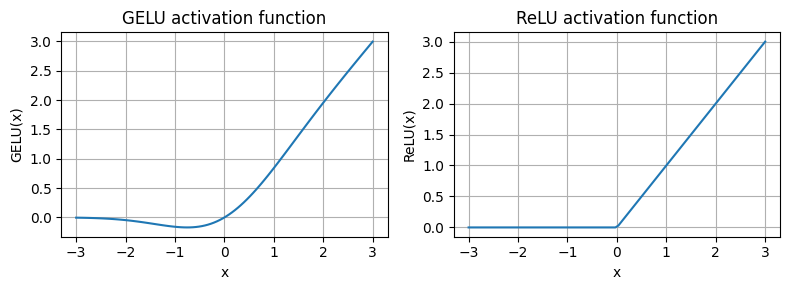

In [14]:
import matplotlib.pyplot as plt

gelu, relu = GELU(), nn.ReLU()

# Some sample data
x = torch.linspace(-3, 3, 100)
y_gelu, y_relu = gelu(x), relu(x)

plt.figure(figsize=(8, 3))
for i, (y, label) in enumerate(zip([y_gelu, y_relu], ["GELU", "ReLU"]), 1):
    plt.subplot(1, 2, i)
    plt.plot(x, y)
    plt.title(f"{label} activation function")
    plt.xlabel("x")
    plt.ylabel(f"{label}(x)")
    plt.grid(True)

plt.tight_layout()
plt.show()


<div class="alert alert-block alert-info">

Ortaya çıkan grafikte görebileceğimiz gibi, ReLU, pozitifse girdiyi doğrudan çıktı olarak veren; aksi takdirde sıfır çıktısı veren parça parça doğrusal bir fonksiyondur.

GELU, negatif değerler için sıfır olmayan bir eğime sahip olan ancak ReLU'ya yaklaşan düzgün, doğrusal olmayan bir fonksiyondur.

</div>

<div class="alert alert-block alert-warning">

Yukarıdaki şekilde gösterildiği gibi GELU'nun düzgünlüğü, eğitim sırasında daha iyi optimizasyon özelliklerine yol açabilir, çünkü modelin parametrelerinde daha ayrıntılı ayarlamalar yapılmasına olanak tanır.

Buna karşılık, ReLU'nun sıfırda keskin bir köşesi vardır ve bu bazen optimizasyonu zorlaştırabilir,
özellikle çok derin veya karmaşık mimarilere sahip ağlarda.

Dahası, herhangi bir negatif giriş için sıfır çıktı veren RELU'nun aksine, GELU negatif değerler için küçük, sıfır olmayan bir çıktıya izin verir.

Bu özellik, eğitim süreci sırasında negatif girdi alan nöronların öğrenme sürecine pozitif girdilerden daha az ölçüde de olsa katkıda bulunabileceği anlamına gelir.

</div>

<div class="alert alert-block alert-success">

Daha sonra, LLM'nin transformer bloğunda daha sonra kullanacağımız küçük sinir ağı modülü FeedForward'ı uygulamak için GELU fonksiyonunu kullanalım:

</div>

In [16]:
class FeedForward(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.layers = nn.Sequential(
            nn.Linear(cfg["emb_dim"], 4 * cfg["emb_dim"]),
            GELU(),
            nn.Linear(4 * cfg["emb_dim"], cfg["emb_dim"]),
        )

    def forward(self, x):
        return self.layers(x)

In [17]:
print(GPT_CONFIG_124M["emb_dim"])


768


<div class="alert alert-block alert-info">

Önceki kodda görebileceğimiz gibi, FeedForward modülü iki Doğrusal (Linear) katmandan ve bir GELU aktivasyon fonksiyonundan oluşan küçük bir sinir ağıdır.

124 milyon parametreli GPT modelinde, GPT_CONFIG_124M sözlüğü aracılığıyla her biri 768 embedding boyutuna sahip tokenlarla giriş gruplarını alır; burada GPT_CONFIG_124M["emb_dim"] = 768'dir.

</div>

In [18]:
ffn = FeedForward(GPT_CONFIG_124M)
x = torch.rand(2, 3, 768) #A
out = ffn(x)
print(out.shape)

torch.Size([2, 3, 768])


<div class="alert alert-block alert-warning">

Bu bölümde uyguladığımız FeedForward modülü, modelin verilerden öğrenme ve verileri genelleştirme yeteneğini geliştirmede önemli bir rol oynar.

Bu modülün giriş ve çıkış boyutları aynı olsa da, ilk doğrusal katman aracılığıyla embedding boyutunu dahili olarak daha yüksek boyutlu bir alana genişletir.

Bu genişlemeyi doğrusal olmayan bir GELU aktivasyonu ve ardından ikinci doğrusal dönüşümle orijinal boyuta geri daralma izler.

Böyle bir tasarım daha zengin bir temsil alanının keşfedilmesine olanak tanır.

</div>

<div class="alert alert-block alert-warning">

Üstelik, giriş ve çıkış boyutlarındaki tekdüzelik, daha sonra yapacağımız gibi, aralarındaki boyutları ayarlamaya gerek kalmadan, birden fazla katmanın istiflenmesini sağlayarak mimariyi basitleştirir ve böylece modeli daha ölçeklenebilir hale getirir.

</div>

## GPT MİMARİSİ PART 4: SHORTCUT/SKIP BAĞLANTILARI

<div class="alert alert-block alert-success">

Forward metoduna shourtcut/skip bağlantıları nasıl ekleyebileceğimizi görelim:

</div>

In [20]:
class ExampleDeepNeuralNetwork(nn.Module):
    def __init__(self, layer_sizes, use_shortcut):
        super().__init__()
        self.use_shortcut = use_shortcut
        self.layers = nn.ModuleList([
            nn.Sequential(nn.Linear(layer_sizes[0], layer_sizes[1]), GELU()),
            nn.Sequential(nn.Linear(layer_sizes[1], layer_sizes[2]), GELU()),
            nn.Sequential(nn.Linear(layer_sizes[2], layer_sizes[3]), GELU()),
            nn.Sequential(nn.Linear(layer_sizes[3], layer_sizes[4]), GELU()),
            nn.Sequential(nn.Linear(layer_sizes[4], layer_sizes[5]), GELU())
        ])

    def forward(self, x):
        for layer in self.layers:
            # Compute the output of the current layer
            layer_output = layer(x)
            # Check if shortcut can be applied
            if self.use_shortcut and x.shape == layer_output.shape:
                x = x + layer_output
            else:
                x = layer_output
        return x


<div class="alert alert-block alert-info">

Kod, her biri bir Doğrusal (Linear)
katman ve bir GELU aktivasyon fonksiyonundan oluşan 5 katmanlı derin bir sinir ağı uygular.

İleri geçişte (forward pass), girdiyi katmanlar arasında yinelemeli olarak geçiririz ve self.use_shortcut niteliği True olarak ayarlanmışsa isteğe bağlı olarak kısayol bağlantıları ekleriz.

</div>

<div class="alert alert-block alert-success">

Shourtcut/skip bağlantıları olmadan bir sinir ağını ilk olarak başlatmak için bu kodu kullanalım. Burada,
her katman, 3 giriş değerine sahip bir örneği kabul edecek ve
3 çıkış değeri döndürecek şekilde başlatılacaktır. Son katman tek bir çıkış değeri döndürecektir:

</div>

In [22]:
layer_sizes = [3, 3, 3, 3, 3, 1]
sample_input = torch.tensor([[1., 0., -1.]])
torch.manual_seed(123) # yeniden üretilebilirlik için başlangıç ​​ağırlıkları için rastgele girdiler belirtin
model_without_shortcut = ExampleDeepNeuralNetwork(
layer_sizes, use_shortcut=False
)

<div class="alert alert-block alert-success">

Daha sonra, modelin geriye doğru (backward pass) geçişindeki gradyanları hesaplayan bir fonksiyon uygularız:

</div>

In [23]:
def print_gradients(model, x):
    # Forward pass
    output = model(x)
    target = torch.tensor([[0.]])

    # Hedef ve çıktı arasındaki yakınlığa göre kaybı (loss) hesaplayın
    loss = nn.MSELoss()
    loss = loss(output, target)
    
    # Gradyanları hesaplamak için backward pass
    loss.backward()

    for name, param in model.named_parameters():
        if 'weight' in name:
            # Ağırlıkların ortalama mutlak eğimini yazdır
            print(f"{name} has gradient mean of {param.grad.abs().mean().item()}")

<div class="alert alert-block alert-warning">

Önceki kodda, model çıktısının ve kullanıcı tarafından belirtilen hedefin (burada, basitlik açısından, 0 değeri) ne kadar yakın olduğunu hesaplayan bir kayıp işlevi belirtiyoruz.

Ardından, loss.backward() çağrıldığında, PyTorch modeldeki her katman için kayıp eğimini hesaplar.

Ağırlık parametrelerini model.named_parameters() aracılığıyla yineleyebiliriz.

Belirli bir katman için 3×3'lük bir ağırlık parametresi matrisimiz olduğunu varsayalım.

Bu durumda, bu katman 3×3 eğim değerlerine sahip olacak ve katmanlar arasındaki eğimleri daha kolay karşılaştırmak için katman başına tek bir eğim değeri elde etmek amacıyla bu 3×3 eğim değerlerinin ortalama mutlak eğimini yazdıracağız.

</div>

<div class="alert alert-block alert-warning">

Kısacası, .backward() yöntemi, PyTorch'ta, eğim hesaplaması için matematiği kendimiz uygulamadan, model eğitimi sırasında gerekli olan kayıp eğimlerini hesaplayan kullanışlı bir yöntemdir, böylece derin sinir ağlarıyla çalışmayı çok daha erişilebilir hale getirir.

</div>

<div class="alert alert-block alert-success">

Şimdi print_gradients fonksiyonunu kullanalım ve bunu skip_connection kullanmadan modele uygulayalım:

</div>

In [24]:
print_gradients(model_without_shortcut, sample_input)

layers.0.0.weight has gradient mean of 0.00020173587836325169
layers.1.0.weight has gradient mean of 0.0001201116101583466
layers.2.0.weight has gradient mean of 0.0007152041071094573
layers.3.0.weight has gradient mean of 0.0013988735154271126
layers.4.0.weight has gradient mean of 0.005049645435065031


<div class="alert alert-block alert-info">

print_gradients fonksiyonunun çıktısına dayanarak görebileceğimiz gibi, son katmandan (layers.4) ilk katmana (layers.0) doğru ilerledikçe gradyanlar küçülür; bu da kaybolan gradyan (vanishing gradient) problemi adı verilen bir olgudur.
    
</div>

<div class="alert alert-block alert-success">

Şimdi skip_connection bağlantıları olan bir model oluşturalım ve nasıl karşılaştırıldığını görelim:

</div>

In [25]:
torch.manual_seed(123)
model_with_shortcut = ExampleDeepNeuralNetwork(
layer_sizes, use_shortcut=True
)
print_gradients(model_with_shortcut, sample_input)

layers.0.0.weight has gradient mean of 0.22169791162014008
layers.1.0.weight has gradient mean of 0.20694106817245483
layers.2.0.weight has gradient mean of 0.32896995544433594
layers.3.0.weight has gradient mean of 0.2665732204914093
layers.4.0.weight has gradient mean of 1.3258540630340576


<div class="alert alert-block alert-info">
Gördüğümüz gibi, çıktıya göre, son katman (layers.4) hala diğer katmanlardan daha büyük bir eğime sahip.

Ancak, eğim değeri ilk katmana (layers.0) doğru ilerledikçe sabitleniyor ve kaybolacak kadar küçük bir değere düşmüyor.
</div>

<div class="alert alert-block alert-warning">

Sonuç olarak, shortcut bağlantıları derin sinir ağlarındaki kaybolan eğim (vanishing gradient) probleminin getirdiği sınırlamaların üstesinden gelmek için önemlidir.

Shortcut bağlantıları LLM'ler gibi çok büyük modellerin temel yapı taşıdır ve GPT modelini eğittiğimizde katmanlar arasında tutarlı eğim akışı sağlayarak daha etkili eğitimin kolaylaştırılmasına yardımcı olacaktır.

</div>

## GPT MİMARİSİ PART 5: BİR TRANSFORMER BLOĞUNDA ATTENTİON VE LINEAR KATMANLARIN KODLANMASI

<div class="alert alert-block alert-success">
Bir transformer bloğunu aşağıdaki gibi kodlayalım:
</div>

<div class="alert alert-block alert-info">

Adım 1: Attention blok için shortcut bağlantıları

Adım 2: Feed forward blok için Shortcut bağlantıları

Adım 3: Orijinal girişi geri ekle
</div>

In [26]:
class MultiHeadAttention(nn.Module):
    def __init__(self, d_in, d_out, context_length, dropout, num_heads, qkv_bias=False):
        super().__init__()
        assert (d_out % num_heads == 0), \
            "d_out must be divisible by num_heads"

        self.d_out = d_out
        self.num_heads = num_heads
        self.head_dim = d_out // num_heads # İstenilen çıkış boyutuyla eşleşecek şekilde projeksiyon boyutunu azaltın

        self.W_query = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.W_key = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.W_value = nn.Linear(d_in, d_out, bias=qkv_bias)
        self.out_proj = nn.Linear(d_out, d_out)  # Head çıkışlarını birleştirmek için doğrusal katman
        self.dropout = nn.Dropout(dropout)
        self.register_buffer(
            "mask",
            torch.triu(torch.ones(context_length, context_length),
                       diagonal=1)
        )

    def forward(self, x):
        b, num_tokens, d_in = x.shape

        keys = self.W_key(x) # Shape: (b, num_tokens, d_out)
        queries = self.W_query(x)
        values = self.W_value(x)

        # Matrisi örtük olarak `num_heads` boyutunu ekleyerek böldük
        # Son boyut: (b, num_tokens, d_out) -> (b, num_tokens, num_heads, head_dim)
        keys = keys.view(b, num_tokens, self.num_heads, self.head_dim) 
        values = values.view(b, num_tokens, self.num_heads, self.head_dim)
        queries = queries.view(b, num_tokens, self.num_heads, self.head_dim)

        # Transpose: (b, num_tokens, num_heads, head_dim) -> (b, num_heads, num_tokens, head_dim)
        keys = keys.transpose(1, 2)
        queries = queries.transpose(1, 2)
        values = values.transpose(1, 2)

        # Causel bir maske ile ölçeklenmiş nokta çarpım attentionını (diğer adıyla öz dikkat) hesaplayın
        attn_scores = queries @ keys.transpose(2, 3)  # Her head için okta çarpım

        # Orijinal maske, token sayısına bölündü ve Boolean'a dönüştürüldü
        mask_bool = self.mask.bool()[:num_tokens, :num_tokens]

        # Attention skorlarını doldurmak için maskeyi kullan
        attn_scores.masked_fill_(mask_bool, -torch.inf)
        
        attn_weights = torch.softmax(attn_scores / keys.shape[-1]**0.5, dim=-1)
        attn_weights = self.dropout(attn_weights)

        # Boyut: (b, num_tokens, num_heads, head_dim)
        context_vec = (attn_weights @ values).transpose(1, 2) 
        
        # Head'leri birleştirelim -> self.d_out = self.num_heads * self.head_dim
        context_vec = context_vec.contiguous().view(b, num_tokens, self.d_out)
        context_vec = self.out_proj(context_vec) # optional projection

        return context_vec

In [27]:
class TransformerBlock(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.att = MultiHeadAttention(
            d_in=cfg["emb_dim"],
            d_out=cfg["emb_dim"],
            context_length=cfg["context_length"],
            num_heads=cfg["n_heads"], 
            dropout=cfg["drop_rate"],
            qkv_bias=cfg["qkv_bias"])
        self.ff = FeedForward(cfg)
        self.norm1 = LayerNorm(cfg["emb_dim"])
        self.norm2 = LayerNorm(cfg["emb_dim"])
        self.drop_shortcut = nn.Dropout(cfg["drop_rate"])

    def forward(self, x):
        # Attention blok için shortcut bağlantısı
        shortcut = x
        x = self.norm1(x)
        x = self.att(x)  # Boyut [batch_size, num_tokens, emb_size]
        x = self.drop_shortcut(x)
        x = x + shortcut  # Orijinal girişi geri ekle

        # Feed forward blok için shortcut bağlantısı
        shortcut = x
        x = self.norm2(x)
        x = self.ff(x)
        x = self.drop_shortcut(x)
        x = x + shortcut  # Orijinal girişi geri ekle

        return x

<div class="alert alert-block alert-warning">

Verilen kod, PyTorch'ta MultiHeadAttention ve FeedForward içeren bir TransformerBlock sınıfını tanımlar, her ikisi de GPT_CONFIG_124M gibi sağlanan bir cfg'ye göre yapılandırılmıştır.

</div>

<div class="alert alert-block alert-warning">

LayerNorm bu iki bileşenin her birinden önce uygulanır ve
dropout, modeli düzenlemek ve aşırı uyumu önlemek için bunlardan sonra uygulanır.

Buna Pre-LayerNorm da denir.

Orijinal transformer modeli gibi eski mimariler,
katman normalizasyonunu, self-attention ve feed-forward ağlardan sonra uygulardı. Bu
Post-LayerNorm olarak bilinir ve genellikle daha kötü eğitim dinamiklerine yol açar.

</div>

<div class="alert alert-block alert-warning">

Sınıf ayrıca, her bileşenin bloğun girdisini çıktısına ekleyen bir shortcut bağlantısı tarafından takip edildiği forward pass da uygular. Bu kritik özellik, eğitim sırasında gradyanın ağ üzerinden akmasına yardımcı olur ve derin modellerin öğrenimini iyileştirir.

</div>

<div class="alert alert-block alert-success">
Daha önce tanımladığımız GPT_CONFIG_124M vocabulary'sini kullanarak bir transformatör bloğu oluşturalım ve ona bazı örnek veriler verelim.
</div>

<div class="alert alert-block alert-info">

[batch_size, num_tokens, emb_dim] şeklindeki örnek girdiyi oluşturun.

</div>

In [28]:
torch.manual_seed(123)
x = torch.rand(2, 4, 768) #A
block = TransformerBlock(GPT_CONFIG_124M)
output = block(x)
print("Input shape:", x.shape)
print("Output shape:", output.shape)

Input shape: torch.Size([2, 4, 768])
Output shape: torch.Size([2, 4, 768])


<div class="alert alert-block alert-info">

Kod çıktısından da görebileceğimiz gibi, transformer blok, girdi boyutlarını çıktısında korur; bu da transformer mimarisinin veri dizilerini, ağ boyunca şekillerini değiştirmeden işlediğini gösterir.
</div>

<div class="alert alert-block alert-warning">
    
Transformer blok mimarisi boyunca şeklin korunması tesadüfi değil, tasarımının önemli bir yönüdür.

Bu tasarım, her çıkış vektörünün doğrudan bir giriş vektörüne karşılık geldiği ve bire bir ilişkinin korunduğu çok çeşitli sequence-to-sequence görevlerine etkili bir şekilde uygulanmasını sağlar.
</div>

<div class="alert alert-block alert-warning">

Ancak çıktı, tüm giriş dizisinden gelen bilgileri kapsülleyen bir context vektörüdür.

Bu, dizinin fiziksel boyutları (uzunluk ve özellik boyutu) transformer bloktan geçerken değişmeden kalırken, her çıkış vektörünün içeriğinin tüm giriş dizisinden gelen bağlamsal bilgileri entegre etmek için yeniden kodlandığı anlamına gelir.

</div>

## GPT MİMARİSİ PART 6: TÜM GPT MODEL MİMARİSİNİN UYGULAMASI

<div class="alert alert-block alert-info">

Cihaz ayarı, giriş verilerinin hangi cihazda bulunduğuna bağlı olarak modeli bir CPU veya GPU üzerinde eğitmemize olanak tanır
    
</div>

In [29]:
class GPTModel(nn.Module):
    def __init__(self, cfg):
        super().__init__()
        self.tok_emb = nn.Embedding(cfg["vocab_size"], cfg["emb_dim"])
        self.pos_emb = nn.Embedding(cfg["context_length"], cfg["emb_dim"])
        self.drop_emb = nn.Dropout(cfg["drop_rate"])
        
        self.trf_blocks = nn.Sequential(
            *[TransformerBlock(cfg) for _ in range(cfg["n_layers"])])
        
        self.final_norm = LayerNorm(cfg["emb_dim"])
        self.out_head = nn.Linear(
            cfg["emb_dim"], cfg["vocab_size"], bias=False
        )

    def forward(self, in_idx):
        batch_size, seq_len = in_idx.shape
        tok_embeds = self.tok_emb(in_idx)
        pos_embeds = self.pos_emb(torch.arange(seq_len, device=in_idx.device))
        x = tok_embeds + pos_embeds  # Shape [batch_size, num_tokens, emb_size] -> input embeddings
        x = self.drop_emb(x)
        x = self.trf_blocks(x)
        x = self.final_norm(x)
        logits = self.out_head(x)
        return logits

<div class="alert alert-block alert-warning">
    
Bu GPTModel sınıfının __init__ oluşturucusu, Python dictionary, cfg aracılığıyla iletilen yapılandırmaları kullanarak token ve positional embedding katmanlarını başlatır.

Bu embedding katmanları, giriş token dizinlerini dense vektörlere dönüştürmekten ve
poistional bilgi eklemekten sorumludur.

</div>

<div class="alert alert-block alert-warning">
    
Daha sonra, __init__ yöntemi cfg'de belirtilen katman sayısına eşit olan TransformerBlock modüllerinin ardışık bir yığınını oluşturur.

Transformer bloklarını takiben, öğrenme sürecini stabilize etmek için transformer bloklarından gelen çıktıları standartlaştıran bir LayerNorm katmanı uygulanır.

Son olarak, önyargısız doğrusal bir çıktı başlığı tanımlanır ve bu, transformer çıktısını tokenizer'ın vocabulary alanına yansıtır ve sözcük dağarcığındaki her token için lojik üretir.
</div>

<div class="alert alert-block alert-warning">
    
Forward methodu, bir grup girdi token endeksi alır, bunların embeddinglerini hesaplar,
poistional embeddingleri uygular, diziyi transformer bloklardan geçirir,
son çıktıyı normalleştirir ve ardından bir sonraki tokenen normalleştirilmemiş olasılıklarını temsil eden lojikleri hesaplar. Bu lojikleri bir sonraki bölümde tokenlara ve metin çıktılarına dönüştüreceğiz.
</div>

<div class="alert alert-block alert-success">
Şimdi, cfg parametresine geçirdiğimiz GPT_CONFIG_124M
sözlüğünü kullanarak 124 milyon parametreli GPT modelini başlatalım ve bu bölümün başında oluşturduğumuz toplu metin girdisi ile besleyelim:
</div>

In [30]:
torch.manual_seed(123)
model = GPTModel(GPT_CONFIG_124M)
out = model(batch)
print("Input batch:\n", batch)
print("\nOutput shape:", out.shape)
print(out)

Input batch:
 tensor([[6109, 3626, 6100,  345],
        [6109, 1110, 6622,  257]])

Output shape: torch.Size([2, 4, 50257])
tensor([[[ 0.3613,  0.4223, -0.0711,  ...,  0.3483,  0.4661, -0.2838],
         [-0.1792, -0.5660, -0.9485,  ...,  0.0477,  0.5181, -0.3168],
         [ 0.7120,  0.0332,  0.1085,  ...,  0.1018, -0.4327, -0.2553],
         [-1.0076,  0.3418, -0.1190,  ...,  0.7195,  0.4023,  0.0532]],

        [[-0.2564,  0.0900,  0.0335,  ...,  0.2659,  0.4454, -0.6806],
         [ 0.1230,  0.3653, -0.2074,  ...,  0.7705,  0.2710,  0.2246],
         [ 1.0558,  1.0318, -0.2800,  ...,  0.6936,  0.3205, -0.3178],
         [-0.1565,  0.3926,  0.3288,  ...,  1.2630, -0.1858,  0.0388]]],
       grad_fn=<UnsafeViewBackward0>)


<div class="alert alert-block alert-info">

Gördüğümüz gibi, her biri 4 tokenlu 2 giriş metni geçirdiğimiz için çıktı tensörü [2, 4, 50257] şeklindedir. Son boyut olan 50.257, tokenizerıb kelime dağarcığı boyutuna karşılık gelir. Bir sonraki bölümde, bu 50.257 boyutlu çıktı vektörlerinin her birini tokenlara nasıl geri dönüştüreceğimizi göreceğiz.
    
</div>

<div class="alert alert-block alert-success">
"Öğe sayısı"nın kısaltması olan numel() yöntemini kullanarak, modelin parametre tensörlerindeki toplam parametre sayısını toplayabiliriz:
</div>

In [31]:
total_params = sum(p.numel() for p in model.parameters())
print(f"Total number of parameters: {total_params:,}")

Total number of parameters: 163,009,536


<div class="alert alert-block alert-danger">
Daha önce 124 milyon parametreli bir GPT modelinin başlatılmasından bahsetmiştik, peki önceki kod çıktısında gösterildiği gibi gerçek parametre sayısı neden 163 milyon?
</div>

<div class="alert alert-block alert-warning">
    
Bunun nedeni, orijinal GPT-2 mimarisinde kullanılan ağırlık bağlama adı verilen bir kavramdır; bu, orijinal GPT-2 mimarisinin token embedding katmanındaki ağırlıkları çıkış katmanında yeniden kullandığı anlamına gelir.

Bunun ne anlama geldiğini anlamak için, daha önce GPTModel aracılığıyla modelde başlattığımız token embedding katmanının ve linear çıkış katmanının boyutlarına bir bakalım:

</div>

In [38]:
print("Token embedding layer shape:", model.tok_emb.weight.shape)
print("Output layer shape:", model.out_head.weight.shape)

Token embedding layer shape: torch.Size([50257, 768])
Output layer shape: torch.Size([50257, 768])


<div class="alert alert-block alert-info">

Çıktılardan görebileceğimiz gibi, bu iki katmanın ağırlık tensörleri aynı boyuta sahiptir:

</div>

<div class="alert alert-block alert-success">
Token embedding ve çıktı katmanları, tokenizer vocabularysindeki 50.257 satır sayısı nedeniyle çok büyüktür. 

Toplam GPT-2 model parametre sayısından ağırlık bağlamaya göre
çıktı katmanı parametre sayısını kaldıralım:
</div>

In [39]:
total_params_gpt2 = total_params - sum(p.numel() for p in model.out_head.parameters())
print(f"Number of trainable parameters considering weight tying: {total_params_gpt2:,}")

Number of trainable parameters considering weight tying: 124,412,160


<div class="alert alert-block alert-info">

Gördüğümüz gibi, model artık sadece 124 milyon parametre büyüklüğünde ve GPT-2 modelinin orijinal boyutuyla eşleşiyor.

</div>

<div class="alert alert-block alert-warning">
    
Ağırlık bağlama, modelin genel bellek ayak izini ve hesaplama karmaşıklığını azaltır. Ancak, deneyimime göre, ayrı token embedding ve çıktı katmanları kullanmak
daha iyi eğitim ve model performansıyla sonuçlanır; bu nedenle, GPTModel uygulamamızda
ayrı katmanlar kullanıyoruz. Aynısı modern LLM'ler için de geçerlidir.

</div>

<div class="alert alert-block alert-success">
Son olarak, GPTModel nesnemizdeki 163 milyon parametrenin bellek gereksinimlerini hesaplayalım:
</div>

In [32]:
total_size_bytes = total_params * 4 #A
total_size_mb = total_size_bytes / (1024 * 1024) #B
print(f"Total size of the model: {total_size_mb:.2f} MB")

Total size of the model: 621.83 MB


<div class="alert alert-block alert-warning">
    
Sonuç olarak, GPTModel nesnemizdeki 163 milyon parametre için bellek gereksinimlerini hesaplayarak ve her parametrenin 4 bayt kaplayan 32 bitlik bir floating point olduğunu varsayarak, modelin toplam boyutunun 621,83 MB olduğunu ve nispeten küçük LLM'leri bile barındırmak için gereken nispeten büyük depolama kapasitesini gösterdiğini görüyoruz.

</div>

<div class="alert alert-block alert-warning">
    
Bu bölümde, GPTModel mimarisini uyguladık ve bunun [batch_size, num_tokens, vocab_size] biçiminde sayısal tensörler ürettiğini gördük. Bir sonraki bölümde, bu çıktı tensörlerini metne dönüştürmek için kodu yazacağız.

</div>

## GPT MİMARİSİ PART 7: ÇIKTI TOKENLARINDAN METİN ÜRETME

Bu aşamaya geçmeden önce hadi gelin model genel olarak nasıl çalışır inceleyelim. Yani basitçe model nasıl bir sonraki token'ı tahmin eder. Daha önceki bölümlerden hatırladığımız gibi model next word prediction premsibine göre çalışır. Aşağıdaki görselde de tam olarak bu yaklaşım görselleştirlmiştir.

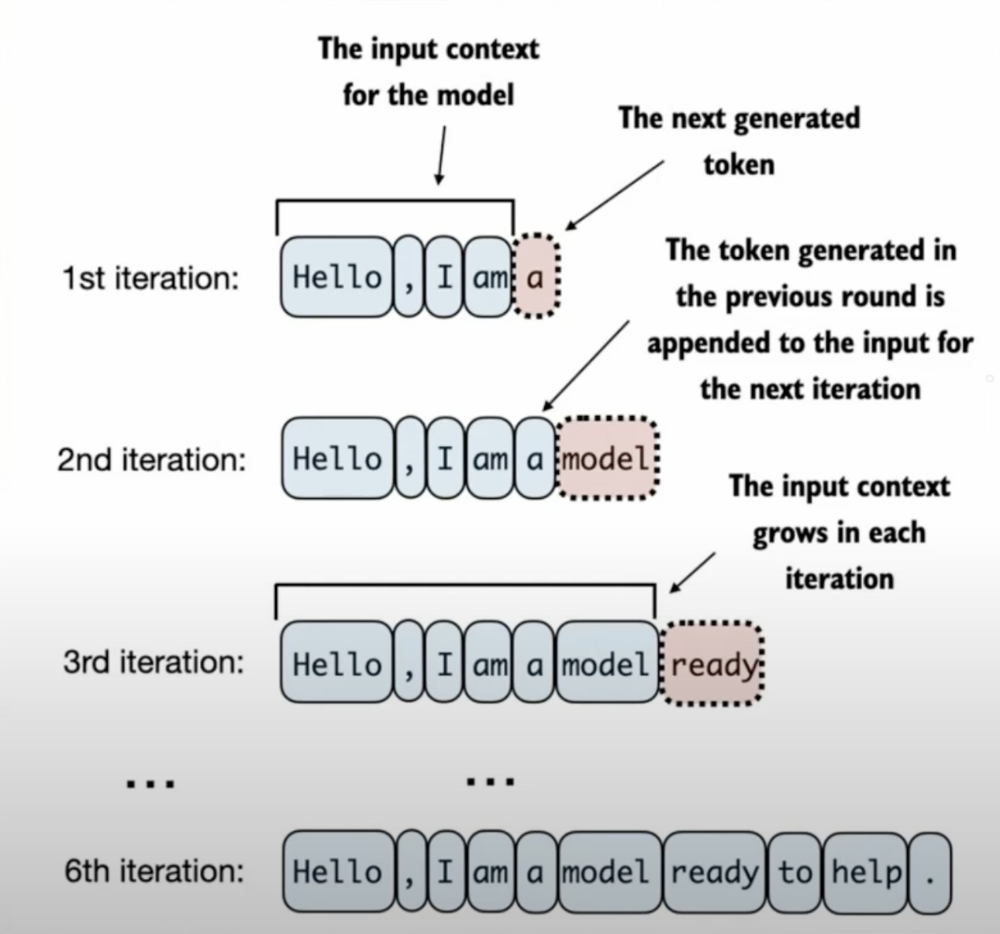

Peki bu süreci diyagramlar üzerinde daha da alt basamaklara ayırarak incelersek;

1. 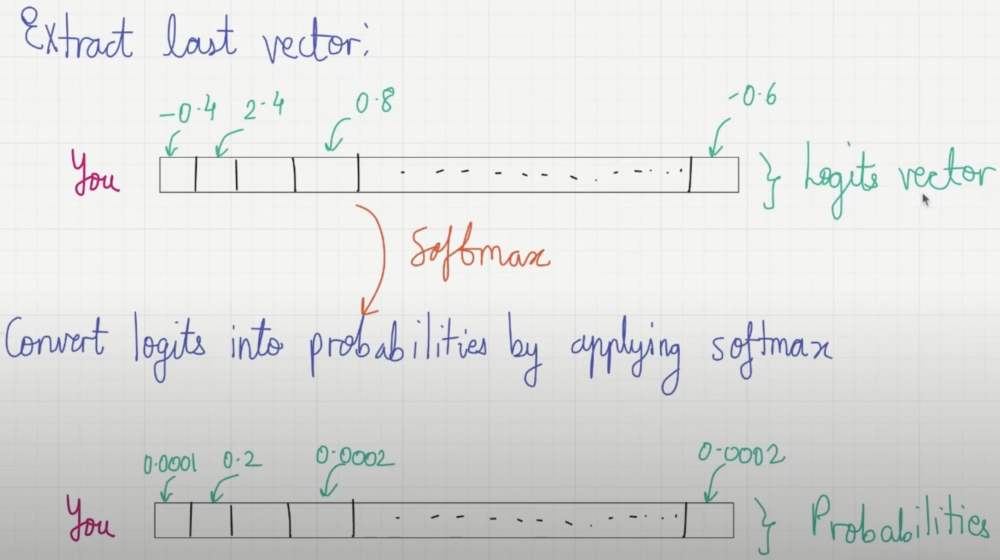

2. 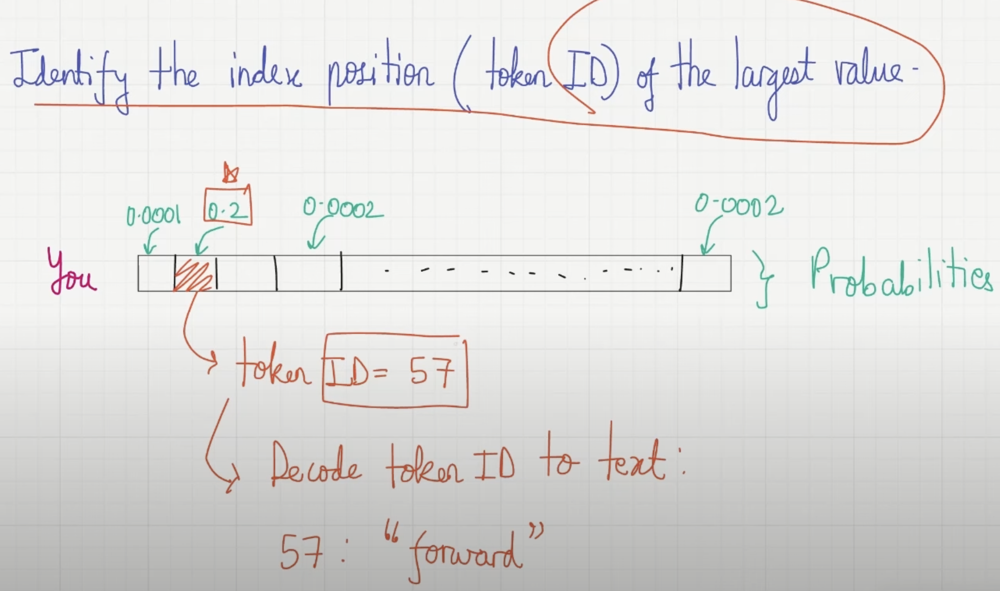

3. Bir sonraki tur için önceki girdilere token-id'leri ekleyin.

Hadi şimdi bir genel diyagram üzerinde tüm LLM sürecini inceleyelim;

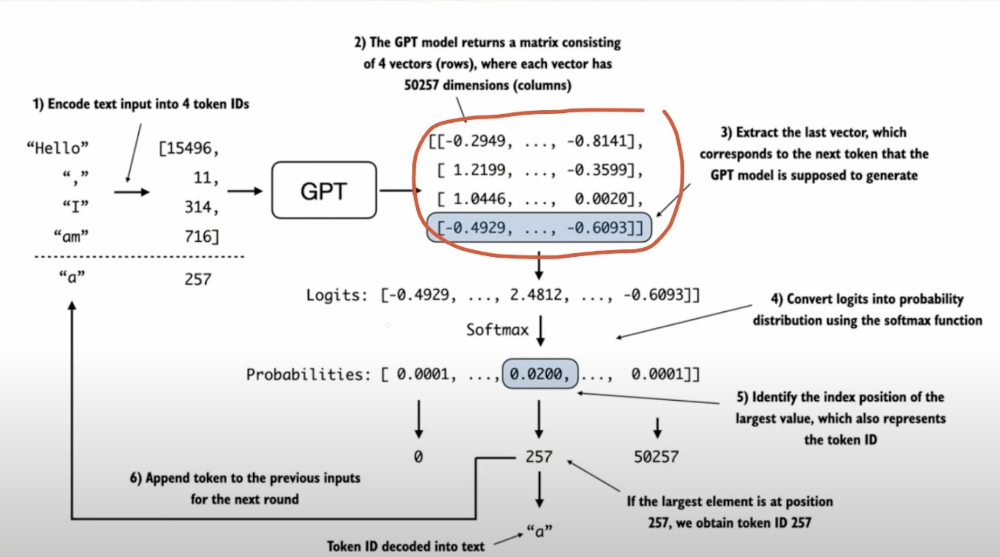

Yukarıdaki diyagram tüm GPT mimarisin bir özetidir.
Birinci yinelemede, modele "Hello, I'm"e karşılık gelen token'ları sağlar ve en yüksek olasılağa sahip olan 257 token-idsine sahip "a" tokenını girişe ekler. Bu süreç, model tam cümleyi üretene kadar tekrarlanır!
Son olarak 6 iterasyondan sonra model "Hello, I'm a model ready to help." çıktısını üretir.

Bu adım adım süreç, modelin ilkeyi ardışık olarak üretmesini ve ilk girdiden tutarlı ifadeler oluşturmasını sağlar.

Uygulamada, kullanıcı tarafından belirtilen sayıda üretilen token'a ulaşana kadar bu süreci birçok yineleme boyunca tekrarlarız.

Son olarak bu iteratif süreci aşağıdaki diyagramdaki gibi görselleştirebiliriz;

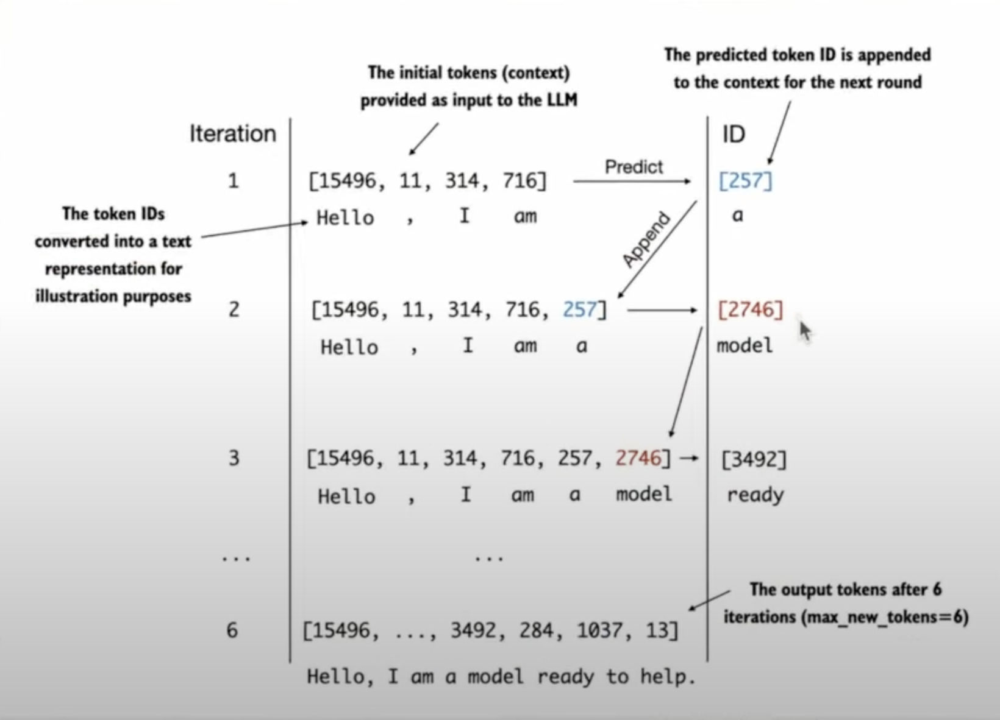

<div class="alert alert-block alert-success">
Token oluşturma sürecini aşağıdaki gibi uygulayalım:
</div>

<div class="alert alert-block alert-info">

Adım 1: idx, geçerli contextdeki (batch, n_token) dizin dizisidir

Adım 2: Desteklenen context boyutunu aşarsa geçerli contexti kırpın Örn., LLM yalnızca 5 tokenı destekliyorsa ve context boyutu 10 ise yalnızca son 5 token context olarak kullanılır.

Adım 3: Yalnızca son zaman adımına odaklanın, böylece (batch, n_token, vocab_size) (batch, vocab_size) olur

Adım 4: probas'ın şekli (batch, vocab_size)'dır

Adım 5: idx_next'in şekli (batch, 1)'dir

Adım 6: Örneklenmiş dizini, idx'in şekli (batch, n_token+1) olacak şekilde çalışan dizine ekleyin

</div>

In [33]:
def generate_text_simple(model, idx, max_new_tokens, context_size):
    # idx, geçerli contextdeki dizinlerin (batch, n_tokens) dizisidir
    for _ in range(max_new_tokens):
        
        # Desteklenen context boyutunu aşarsa geçerli contexti kırp
        # Örn., LLM yalnızca 5 token destekliyorsa ve context boyutu 10 ise
        # o zaman yalnızca son 5 token context olarak kullanılır
        idx_cond = idx[:, -context_size:]
        
        # Tahminleri al
        with torch.no_grad():
            logits = model(idx_cond)
        
        # Sadece son zaman adımına odaklan
        # (batch, n_tokens, vocab_size) (batch, vocab_size) olur
        logits = logits[:, -1, :]  

        # Olasılıkları almak için softmax uygulayın
        probas = torch.softmax(logits, dim=-1)  # (batch, vocab_size)

        # En yüksek olasılık değerine sahip kelime girişinin idx'ini al
        idx_next = torch.argmax(probas, dim=-1, keepdim=True)  # (batch, 1)

        # Örneklenen dizini çalışan dizine ekle
        idx = torch.cat((idx, idx_next), dim=1)  # (batch, n_tokens+1)

    return idx

<div class="alert alert-block alert-warning">
    
Önceki kodda, generate_text_simple fonksiyonunda, lojikleri torch.argmax aracılığıyla en yüksek değere sahip konumu belirlediğimiz bir olasılık dağılımına dönüştürmek için softmax fonksiyonunu kullanıyoruz.

Softmax fonksiyonu monotoniktir, yani girdilerinin çıktılara dönüştürüldüğünde sırasını korur.

Bu nedenle, pratikte softmax adımı gereksizdir çünkü softmax çıktı tensöründeki en yüksek puana sahip konum lojik tensöründeki konumla aynıdır.

Başka bir deyişle, torch.argmax fonksiyonunu doğrudan lojik tensörüne uygulayabilir ve aynı sonuçları elde edebiliriz.

Ancak, dönüşümü lojikleri olasılıklara dönüştürmenin tam sürecini göstermek için kodladık, bu da modelin en olası bir sonraki token'ı üretmesi gibi ek sezgiler sağlayabilir, buna greedy decoding denir.

</div>

<div class="alert alert-block alert-warning">
    
Bir sonraki bölümde, GPT eğitim kodunu uygulayacağımızda, softmax çıktılarını değiştirdiğimiz ek örnekleme (sampling) tekniklerini de tanıtacağız; böylece model her zaman en olası tokenı seçmeyecek ve bu da oluşturulan metinde değişkenlik ve yaratıcılık sağlayacak.

</div>

<div class="alert alert-block alert-success">
Şimdi generate_text_simple fonksiyonunu "Hello, I'm" context'iyle model girişi olarak deneyelim;
</div>

<div class="alert alert-block alert-success">
İlk olarak, giriş contextini token-id'lerine kodluyoruz:
</div>

In [34]:
start_context = "Hello, I am"
encoded = tokenizer.encode(start_context)
print("encoded:", encoded)
encoded_tensor = torch.tensor(encoded).unsqueeze(0) #A
print("encoded_tensor.shape:", encoded_tensor.shape)

encoded: [15496, 11, 314, 716]
encoded_tensor.shape: torch.Size([1, 4])


<div class="alert alert-block alert-success">
Sonra, modeli .eval() moduna alıyoruz, bu da yalnızca eğitim sırasında kullanılan dropout gibi rastgele bileşenleri devre dışı bırakıyor ve encoded giriş tensöründe generate_text_simple fonksiyonunu kullanıyor:
</div>

<div class="alert alert-block alert-info">

Dropout'u kapattık çünkü  modeli eğitmiyoruz.

</div>

In [35]:
model.eval() #A
out = generate_text_simple(
model=model,
idx=encoded_tensor,
max_new_tokens=6,
context_size=GPT_CONFIG_124M["context_length"]
)
print("Output:", out)
print("Output length:", len(out[0]))

Output: tensor([[15496,    11,   314,   716, 27018, 24086, 47843, 30961, 42348,  7267]])
Output length: 10


<div class="alert alert-block alert-success">
Tokenizer'ın .decode metodunu kullanarak kimlikleri tekrar metne dönüştürebiliriz:
</div>

In [44]:
decoded_text = tokenizer.decode(out.squeeze(0).tolist())
print(decoded_text)

Hello, I am Featureiman Byeswickattribute argue


<div class="alert alert-block alert-info">

Gördüğümüz gibi, önceki çıktıya dayanarak, model anlamsız bir şey üretti, bu da hiç de tutarlı bir metin değil.

Ne oldu?

Modelin tutarlı bir metin üretememesinin nedeni, henüz onu eğitmemiş olmamızdır.

Şimdiye kadar, sadece GPT mimarisini uyguladık ve başlangıçta rastgele ağırlıklarla bir GPT model örneği başlattık.

</div>